In [195]:
# import libraries
import numpy as np
import pandas as pd
import matplotlib.pyplot as plt
import seaborn as sns
from scipy import stats
import plotly.express as px
from sklearn.preprocessing import OneHotEncoder


# splitting our data into train and test sets
from sklearn.model_selection import train_test_split
# For Scaling Data
from sklearn.preprocessing import StandardScaler
# Logistic Regression
from sklearn.linear_model import LogisticRegression
# PCA
from sklearn.decomposition import PCA
# KNN
from sklearn.neighbors import KNeighborsClassifier
# Decision Trees
from sklearn.tree import DecisionTreeClassifier
# SVC
from sklearn.svm import LinearSVC
# To cross-validate
from sklearn.model_selection import cross_val_score
# To build a pipeline
from sklearn.pipeline import Pipeline
# To do a cross-validated grid search
from sklearn.model_selection import GridSearchCV
#import warnings
#warnings.filterwarnings("ignore")

In [2]:
#!pip install geopy # Needed for Distance calculation
from geopy import distance
from geopy import Point

In [3]:
pd.options.display.max_columns = 999

In [4]:
# Read in the data 
df = pd.read_csv('data/flight data.csv')

In [5]:
# Verify data
df.head()

,from_airport_code,from_country,dest_airport_code,dest_country,aircraft_type,airline_number,airline_name,flight_number,departure_time,arrival_time,duration,stops,price,currency,co2_emissions,avg_co2_emission_for_this_route,co2_percentage,scan_date
0,ALG,Algeria,AEP,Argentina,Airbus A318|Canadair RJ 1000|Airbus A330|Airbu...,multi,[Air France| Iberia| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1320000.0,1320000.0,0%,2022-04-29 17:52:59
1,ALG,Algeria,AEP,Argentina,Airbus A318|Canadair RJ 1000|Boeing 787|Airbus...,multi,[Air France| Iberia| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1195000.0,1320000.0,-9%,2022-04-29 17:52:59
2,ALG,Algeria,AEP,Argentina,Airbus A320|Airbus A321|Boeing 787|Airbus A320,multi,[Air France| LATAM],AF1855|AF1855|AF1855|AF1855,2022-04-30 12:45:00,2022-05-01 10:15:00,1530,3,1284.0,USD,1248000.0,1320000.0,-5%,2022-04-29 17:52:59
3,ALG,Algeria,AEP,Argentina,Airbus A318|Airbus A320|Boeing 787|Airbus A320,multi,[Air France| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1290.0,USD,1347000.0,1320000.0,2%,2022-04-29 17:52:59
4,ALG,Algeria,AEP,Argentina,Airbus A321neo|Boeing 777|Airbus A320,multi,[Lufthansa| LATAM],LH1317|LH1317|LH1317,2022-04-30 12:35:00,2022-05-01 10:15:00,1540,2,1347.0,USD,1381000.0,1320000.0,4%,2022-04-29 17:52:59


In [6]:
print('\Data Shape:', df.shape)
print('\nNumber of rows:', df.shape[0])
print('\nNumber of columns:', df.shape[1])

\Data Shape: (998866, 18)

Number of rows: 998866

Number of columns: 18


In [7]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 998866 entries, 0 to 998865
Data columns (total 18 columns):
 #   Column                           Non-Null Count   Dtype  
---  ------                           --------------   -----  
 0   from_airport_code                998866 non-null  object 
 1   from_country                     998866 non-null  object 
 2   dest_airport_code                998866 non-null  object 
 3   dest_country                     998866 non-null  object 
 4   aircraft_type                    984952 non-null  object 
 5   airline_number                   998866 non-null  object 
 6   airline_name                     998866 non-null  object 
 7   flight_number                    998866 non-null  object 
 8   departure_time                   998866 non-null  object 
 9   arrival_time                     998866 non-null  object 
 10  duration                         998866 non-null  int64  
 11  stops                            998866 non-null  int64  
 12  pr

# Data Wrangling / Cleaning:
1. Need to convert departure times to datetime - DONE
2. Need to convert arrival times to datetime - DONE
3. Need to add Departure city - DONE
4. Need to add Arrival city - DONE
5. Need to add UTC adjustment for departure time
6. Need to add UTC adjustment for arrival time
7. Verify CO2 emmissions - lbs, kgs? - DONE
8. Verify/Remove Nulls / NAs - DONE
9. Verify/Remove Duplicates - DONE
10. Scan Date Importance? Remove - DONE
11. Flight Number Duplication? - DONE
12. Split Aircraft Type - DONE
13. Remove avg CO2 emission for route? - DONE
14. Remove CO2 percentage? - DONE
15. Calculate Distance between points? Use Latitude and Longitude Points? - DONE
16. Generate Route (From-Dest) - DONE
17. Price per Emissions? - 


In [8]:
list(df.columns.values)

['from_airport_code',
 'from_country',
 'dest_airport_code',
 'dest_country',
 'aircraft_type',
 'airline_number',
 'airline_name',
 'flight_number',
 'departure_time',
 'arrival_time',
 'duration',
 'stops',
 'price',
 'currency',
 'co2_emissions',
 'avg_co2_emission_for_this_route',
 'co2_percentage',
 'scan_date']

In [9]:
print(df.nunique())

from_airport_code                     31
from_country                          18
dest_airport_code                     78
dest_country                          47
aircraft_type                      25675
airline_number                       185
airline_name                       11012
flight_number                      22064
departure_time                      4288
arrival_time                       21164
duration                            4064
stops                                  7
price                              12001
currency                               1
co2_emissions                       8364
avg_co2_emission_for_this_route      956
co2_percentage                       987
scan_date                              1
dtype: int64


### Review Date Columns

In [10]:
df['departure_time'] = pd.to_datetime(df['departure_time'])
df['arrival_time'] = pd.to_datetime(df['arrival_time'])
df['scan_date'] = pd.to_datetime(df['scan_date'])
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 998866 entries, 0 to 998865
Data columns (total 18 columns):
 #   Column                           Non-Null Count   Dtype         
---  ------                           --------------   -----         
 0   from_airport_code                998866 non-null  object        
 1   from_country                     998866 non-null  object        
 2   dest_airport_code                998866 non-null  object        
 3   dest_country                     998866 non-null  object        
 4   aircraft_type                    984952 non-null  object        
 5   airline_number                   998866 non-null  object        
 6   airline_name                     998866 non-null  object        
 7   flight_number                    998866 non-null  object        
 8   departure_time                   998866 non-null  datetime64[ns]
 9   arrival_time                     998866 non-null  datetime64[ns]
 10  duration                         998866 non-

#### Verify Earliest and Latest Date Info

In [11]:
print('The earliest date is: ',df['departure_time'].min())
print('The latest date is: ',df['departure_time'].max())

The earliest date is:  2022-04-30 00:25:00
The latest date is:  2022-08-28 23:59:00


In [12]:
print('The earliest date is: ',df['arrival_time'].min())
print('The latest date is: ',df['arrival_time'].max())

The earliest date is:  2022-04-30 04:10:00
The latest date is:  2022-09-02 06:55:00


In [13]:
print('The earliest date is: ',df['scan_date'].min())
print('The latest date is: ',df['scan_date'].max())

The earliest date is:  2022-04-29 17:52:59
The latest date is:  2022-04-29 17:52:59


Scan date only lists one value, the date the web scrape/mine was done on April 29th, 2022. We can disregard this column as it will not be a factor for EDA and modelling. 

In [14]:
# drop scan_date column
df =df.drop(['scan_date'], axis = 1)

In [15]:
# verify 
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 998866 entries, 0 to 998865
Data columns (total 17 columns):
 #   Column                           Non-Null Count   Dtype         
---  ------                           --------------   -----         
 0   from_airport_code                998866 non-null  object        
 1   from_country                     998866 non-null  object        
 2   dest_airport_code                998866 non-null  object        
 3   dest_country                     998866 non-null  object        
 4   aircraft_type                    984952 non-null  object        
 5   airline_number                   998866 non-null  object        
 6   airline_name                     998866 non-null  object        
 7   flight_number                    998866 non-null  object        
 8   departure_time                   998866 non-null  datetime64[ns]
 9   arrival_time                     998866 non-null  datetime64[ns]
 10  duration                         998866 non-

In [16]:
df.describe()

,duration,stops,price,co2_emissions,avg_co2_emission_for_this_route
count,998866.000000,998866.000000,997513.000000,9.939980e+05,9.104640e+05
mean,1468.213762,1.654926,1763.370116,1.111010e+06,8.626045e+05
std,705.799677,0.652485,1985.988209,9.876891e+05,5.228906e+05
min,55.000000,0.000000,9.000000,4.300000e+04,5.300000e+04
25%,973.000000,1.000000,621.000000,5.220000e+05,4.100000e+05
50%,1410.000000,2.000000,1189.000000,9.560000e+05,8.760000e+05
75%,1880.000000,2.000000,2127.000000,1.367000e+06,1.184000e+06
max,6095.000000,6.000000,33750.000000,1.404400e+07,2.408000e+06


### Verify Duplicates

In [17]:
df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 998866 entries, 0 to 998865
Data columns (total 17 columns):
 #   Column                           Non-Null Count   Dtype         
---  ------                           --------------   -----         
 0   from_airport_code                998866 non-null  object        
 1   from_country                     998866 non-null  object        
 2   dest_airport_code                998866 non-null  object        
 3   dest_country                     998866 non-null  object        
 4   aircraft_type                    984952 non-null  object        
 5   airline_number                   998866 non-null  object        
 6   airline_name                     998866 non-null  object        
 7   flight_number                    998866 non-null  object        
 8   departure_time                   998866 non-null  datetime64[ns]
 9   arrival_time                     998866 non-null  datetime64[ns]
 10  duration                         998866 non-

In [18]:
x = df.duplicated().sum()
y = round((x/df.shape[0])*100,2)

print(f"Total number of duplicate rows:",x)
print(f"The total number of duplicate rows equates to:", y, "%")

Total number of duplicate rows: 51197
The total number of duplicate rows equates to: 5.13 %


In [19]:
# drop duplicate rows
df = df.drop_duplicates().copy()

In [20]:
# Verify Duplicates
x = df.duplicated().sum()
y = round((x/df.shape[0])*100,2)

print(f"Total number of duplicate rows:",x)
print(f"The total number of duplicate rows equates to:", y, "%")

Total number of duplicate rows: 0
The total number of duplicate rows equates to: 0.0 %


### Verify Null Values


In [21]:
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 947669 entries, 0 to 998865
Data columns (total 17 columns):
 #   Column                           Non-Null Count   Dtype         
---  ------                           --------------   -----         
 0   from_airport_code                947669 non-null  object        
 1   from_country                     947669 non-null  object        
 2   dest_airport_code                947669 non-null  object        
 3   dest_country                     947669 non-null  object        
 4   aircraft_type                    933784 non-null  object        
 5   airline_number                   947669 non-null  object        
 6   airline_name                     947669 non-null  object        
 7   flight_number                    947669 non-null  object        
 8   departure_time                   947669 non-null  datetime64[ns]
 9   arrival_time                     947669 non-null  datetime64[ns]
 10  duration                         947669 non-

Missing info in:
- `price`
- `co2_emissions`

In [22]:
x = df['price'].isnull().sum()
y = round((x/df.shape[0])*100,2)
print(f"Total number of price null values:",x)
print(f"The total number of null equates to:", y, "%")

Total number of price null values: 1351
The total number of null equates to: 0.14 %


In [23]:
x = df['co2_emissions'].isnull().sum()
y = round((x/df.shape[0])*100,2)
print(f"Total number of co2_emissions null values:",x)
print(f"The total number of null equates to:", y, "%")

Total number of co2_emissions null values: 4671
The total number of null equates to: 0.49 %


In [24]:
# drop null values
df.dropna(inplace=True)

In [25]:
# verify
df.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 847355 entries, 0 to 998865
Data columns (total 17 columns):
 #   Column                           Non-Null Count   Dtype         
---  ------                           --------------   -----         
 0   from_airport_code                847355 non-null  object        
 1   from_country                     847355 non-null  object        
 2   dest_airport_code                847355 non-null  object        
 3   dest_country                     847355 non-null  object        
 4   aircraft_type                    847355 non-null  object        
 5   airline_number                   847355 non-null  object        
 6   airline_name                     847355 non-null  object        
 7   flight_number                    847355 non-null  object        
 8   departure_time                   847355 non-null  datetime64[ns]
 9   arrival_time                     847355 non-null  datetime64[ns]
 10  duration                         847355 non-

In [26]:
x = df['price'].isnull().sum()
y = round((x/df.shape[0])*100,2)
print(f"Total number of price null values:",x)
print(f"The total number of null equates to:", y, "%")

x = df['co2_emissions'].isnull().sum()
y = round((x/df.shape[0])*100,2)
print(f"Total number of co2_emissions null values:",x)
print(f"The total number of null equates to:", y, "%")

Total number of price null values: 0
The total number of null equates to: 0.0 %
Total number of co2_emissions null values: 0
The total number of null equates to: 0.0 %


In [27]:
# reset index
df.reset_index(drop = True, inplace = True)

In [28]:
# verify 
df.tail()

,from_airport_code,from_country,dest_airport_code,dest_country,aircraft_type,airline_number,airline_name,flight_number,departure_time,arrival_time,duration,stops,price,currency,co2_emissions,avg_co2_emission_for_this_route,co2_percentage
847350,BOM,India,SYD,Australia,Boeing 777|Airbus A380,EK,[Emirates],EK503|EK503,2022-05-01 19:20:00,2022-05-02 22:05:00,1335,1,1317.0,USD,1567000.0,1133000.0,38%
847351,BOM,India,SYD,Australia,Boeing 777|Airbus A380,EK,[Emirates],EK509|EK509,2022-05-01 22:20:00,2022-05-02 22:05:00,1155,1,1317.0,USD,1583000.0,1133000.0,39%
847352,BOM,India,SYD,Australia,Airbus A350|Boeing 787|Boeing 737,multi,[Etihad| Virgin Australia],EY205|EY205|EY205,2022-05-01 04:35:00,2022-05-02 09:55:00,1490,2,1328.0,USD,1354000.0,1133000.0,19%
847353,BOM,India,SYD,Australia,Airbus A321 (Sharklets)|Airbus A321|Airbus A330,multi,[Air India| SriLankan],AI603|AI603|AI603,2022-05-01 06:10:00,2022-05-02 14:55:00,1695,2,1368.0,USD,1099000.0,1133000.0,-2%
847354,BOM,India,SYD,Australia,Airbus A321 (Sharklets)|Airbus A321|Airbus A330,multi,[Air India| SriLankan],AI639|AI639|AI639,2022-05-01 09:30:00,2022-05-02 14:55:00,1495,2,1368.0,USD,1099000.0,1133000.0,-2%


### Review Airport Codes

In [29]:
df['from_airport_code'].unique()

array(['ALG', 'AEP', 'SYD', 'MEL', 'VIE', 'BRU', 'GRU', 'CNF', 'VCP',
       'YYZ', 'SCL', 'CAN', 'CTU', 'SZX', 'PEK', 'SHA', 'XIY', 'PVG',
       'HGH', 'BOG', 'CPH', 'DUB', 'CAI', 'ADD', 'CDG', 'FRA', 'MUC',
       'ATH', 'DEL', 'BOM'], dtype=object)

In [30]:
count_unique = df['from_airport_code'].nunique()
print(count_unique)  

30


In [31]:
df['dest_airport_code'].unique()

array(['AEP', 'VIE', 'BRU', 'YYZ', 'CPH', 'DUB', 'CAI', 'CDG', 'MUC',
       'FRA', 'ATH', 'MXP', 'MEX', 'KUL', 'CMN', 'OSL', 'AMS', 'LIS',
       'FCO', 'DOH', 'JNB', 'ICN', 'MAD', 'ARN', 'SAW', 'IST', 'DXB',
       'LHR', 'LGW', 'MAN', 'ATL', 'ORD', 'LAX', 'PHX', 'MCO', 'MIA',
       'IAH', 'SEA', 'FLL', 'SFO', 'JFK', 'ZRH', 'ALG', 'MEL', 'SYD',
       'GRU', 'CNF', 'SCL', 'SHA', 'HGH', 'PVG', 'BOG', 'DEL', 'BOM',
       'NRT', 'NBO', 'HND', 'PTY', 'MNL', 'SVO', 'LIM', 'DME', 'BKK',
       'TPE', 'CPT', 'CLT', 'SZX', 'VCP', 'CAN', 'PEK', 'CGK', 'BLR',
       'SIN', 'SGN', 'ADD', 'XIY', 'CTU'], dtype=object)

In [32]:
count_unique = df['dest_airport_code'].nunique() 
print(count_unique) 

77


In [33]:
df.head()

,from_airport_code,from_country,dest_airport_code,dest_country,aircraft_type,airline_number,airline_name,flight_number,departure_time,arrival_time,duration,stops,price,currency,co2_emissions,avg_co2_emission_for_this_route,co2_percentage
0,ALG,Algeria,AEP,Argentina,Airbus A318|Canadair RJ 1000|Airbus A330|Airbu...,multi,[Air France| Iberia| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1320000.0,1320000.0,0%
1,ALG,Algeria,AEP,Argentina,Airbus A318|Canadair RJ 1000|Boeing 787|Airbus...,multi,[Air France| Iberia| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1195000.0,1320000.0,-9%
2,ALG,Algeria,AEP,Argentina,Airbus A320|Airbus A321|Boeing 787|Airbus A320,multi,[Air France| LATAM],AF1855|AF1855|AF1855|AF1855,2022-04-30 12:45:00,2022-05-01 10:15:00,1530,3,1284.0,USD,1248000.0,1320000.0,-5%
3,ALG,Algeria,AEP,Argentina,Airbus A318|Airbus A320|Boeing 787|Airbus A320,multi,[Air France| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1290.0,USD,1347000.0,1320000.0,2%
4,ALG,Algeria,AEP,Argentina,Airbus A321neo|Boeing 777|Airbus A320,multi,[Lufthansa| LATAM],LH1317|LH1317|LH1317,2022-04-30 12:35:00,2022-05-01 10:15:00,1540,2,1347.0,USD,1381000.0,1320000.0,4%


#### Add Airport & UTC Timezone Adjustment Information

Info pulled from the airportcodes.aero website (https://airportcodes.aero/) and timezone information was pulled from the timeanddate.com website (https://www.timeanddate.com/)

In [34]:
airport_information = {
    'Airport_Code':[ 'AEP', 'CAN', 'MUC', 'HND', 'LIM', 'CPT', 'LGW', 'IAH', 'HGH', 'SYD', 'SZX', 'FRA', 'NBO', 'LIS', 'MAD', 'MAN', 'SEA', 'CTU', 'MEL', 'PVG', 'DEL', 'MEX', 'FCO', 'TPE', 'ATL', 'FLL', 'XIY', 'VIE', 'BOG', 'ATH', 'KUL', 'DOH', 'ARN', 'ORD', 'SFO', 'VCP', 'GRU', 'CPH', 'BOM', 'CMN', 'SVO', 'BKK', 'LAX', 'JFK', 'CGO', 'BRU', 'DUB', 'CGK', 'OSL', 'SIN', 'SAW', 'PHX', 'ZRH', 'PEK', 'YYZ', 'ADD', 'BLR', 'AMS', 'DME', 'IST', 'MCO', 'ALG', 'CNF', 'CAI', 'MXP', 'PTY', 'JNB', 'DXB', 'CLT', 'SGN', 'SCL', 'CDG', 'NRT', 'MNL', 'ICN', 'LHR', 'MIA', 
                    'SHA'],
    'Airport_Name':["Aeroparque Internacional Jorge Newbery","Guangzhou Baiyun International Airport","Munich Airport","Tokyo-Haneda International Airport","Jorge Chavez International Airport","Cape Town International Airport","London-Gatwick Airport","George Bush Intercontinental Airport","Hangzhou Xiaoshan International Airport","Sydney Airport","Shenzhen Bao'an International Airport","Frankfurt Airport","Jomo Kenyatta International Airport","Humberto Delgado Airport","Adolfo Suárez Madrid–Barajas Airport","Manchester Airport","Seattle-Tacoma International Airport","Chengdu Shuangliu International Airport","Melbourne Airport","Shanghai Pudong International Airport","Indira Gandhi International Airport","Mexico City International Airport","Leonardo da Vinci–Fiumicino Airport","Taoyuan International Airport","Hartsfield–Jackson Atlanta International Airport","Fort Lauderdale–Hollywood International Airport","Xi'an Xianyang International Airport","Vienna International Airport","El Dorado International Airport","Athens International Airport","Kuala Lumpur International Airport","Hamad International Airport","Stockholm-Arlanda Airport","Chicago O'Hare International Airport","San Francisco International Airport","Viracopos International Airport","São Paulo Guarulhos International Airport","Copenhagen Airport","Chhatrapati Shivaji Maharaj International Airport","Mohammed V International Airport","Sheremetyevo Alexander S. Pushkin International Airport","Suvarnabhumi Airport","Los Angeles International Airport","John F. Kennedy International Airport","Zhengzhou Xinzheng International Airport","Brussels Airport","Dublin Airport","Soekarno–Hatta International Airport","Oslo Airport","Singapore Changi Airport","Sabiha Gokcen International Airport","Phoenix Sky Harbor International Airport","Zurich Airport","Beijing Capital International Airport","Toronto Pearson International Airport","Addis Ababa Bole International Airport","Kempegowda International Airport","Amsterdam Airport Schiphol","Moscow Domodedovo Airport","Ataturk International Airport","Orlando International Airport","Houari Boumediene Airport","Tancredo Neves International Airport","Cairo International Airport","Milan Malpensa International Airport","Tocumen International Airport","O. R. Tambo International Airport","Dubai International Airport","Charlotte Douglas International Airport","Tan Son Nhat International Airport","Arturo Merino Benitez International Airport","Paris Charles de Gaulle Airport","Tokyo-Narita International Airport","Ninoy Aquino International Airport","Incheon International Airport","London-Heathrow Airport","Miami International Airport",
                    "Shanghai Hongqiao International Airport"],
    'Airport_City':["Buenos Aires","Guangzhou","Munich","Tokyo","Lima","Cape Town","London","Houston","Hangzhou","Sydney","Shenzhen","Frankfurt","Nairobi","Lisbon","Madrid","Manchester","Seattle","Chengdu","Melbourne","Shanghai","Delhi","Mexico City","Fiumicino","Taipei","Atlanta","Miami","Xi'an","Vienna","Bogota","Athens","Kuala Lumpur","Doha","Stockholm","Chicago","San Francisco","Sao Paulo","Sao Paulo","Copenhagen","Mumbai","Casablanca","Moscow","Bangkok","Los Angeles","New York","Zhengzhou","Brussels","Dublin","Jakarta","Oslo","Singapore","Istanbul","Phoenix","Zurich","Beijing","Toronto","Addis Ababa","Bangalore","Amsterdam","Moscow","Istanbul","Orlando","Algiers","Confins","Cairo","Milan","Panama City","Johannesburg","Dubai","Charlotte","Ho Chi Minh City","Santiago","Paris","Tokyo","Manila","Seoul","London","Miami",
                    "Shanghai"],
    'Airport_Country': ["Argentina","China","Germany","Japan","Peru",
                        "South Africa","United Kingdom","United States of America",
                        "China","Australia","China","Germany","Kenya","Portugal","Spain",
                        "United Kingdom","United States of America","China","Australia","China",
                        "India","Mexico","Italy","Taiwan","United States of America",
                        "United States of America","China","Austria","Colombia","Greece","Malaysia",
                        "Qatar","Sweden","United States of America","United States of America","Brazil",
                        "Brazil","Denmark","India","Morocco","Russia","Thailand","United States of America",
                        "United States of America","China","Belgium","Ireland","Indonesia","Norway",
                        "Singapore","Turkey","United States of America","Switzerland","China","Canada",
                        "Ethiopia","India","Netherlands","Russia","Turkey","United States of America",
                        "Algeria","Brazil","Egypt","Italy","Panama","South Africa","United Arab Emirates",
                        "United States of America","Vietnam","Chile","France","Japan","Philippines","South Korea",
                        "United Kingdom","United States of America","China"],
    'Airport_Timezone_Adj_Hours':[-3,8,1,9,-5,2,0,-6,8,10,8,1,3,0,1,0,-8,8,10,8,5,-6,1,8,-5,-5,8,1,-5,2,8,3,1,-6,-8,-3,-3,1,5,1,3,7,-8,-5,8,1,0,7,1,8,3,
                                  -7,1,8,-5,3,5,1,3,3,-5,1,-3,2,1,-5,2,4,-5,7,-4,1,9,8,9,0,-5,8,],
    'Airport_Timezone_Adj_Mins' :[0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,30,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,30,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,30,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,],
    'Airport_Lat':[-34.5577389000333,23.3961737465643,48.3511109794145,35.5494804083177,-12.0237588747816,-33.9707321566645,51.1537966691745,29.9903964365879,30.2361803134082,-33.9498118844249,22.6370359336888,50.0464385013313,-1.33117001961051,38.7762130903902,40.4984633725195,53.3558534051921,47.4482057538999,30.5476456103965,-33.1651454983468,31.1446043202944,28.5563885500954,19.4363291225696,41.8037152944108,25.0764191795815,33.6422099998983,26.0744078477887,34.4373233461419,48.1128273780094,4.73430379613192,37.9357417891236,2.74306831574282,25.2864324924182,59.6501703931625,41.9805351962813,37.6169339633645,-23.0079482257404,-23.4301793176096,55.617757591627,19.09381604546,33.3700241410235,55.9737862626875,13.6902976061099,33.9502755591614,40.6415799338128,34.5255356432286,50.9016468405679,53.426948602434,-6.11691990670312,60.1980000535908,1.36466689225704,40.9055980244643,33.4354728132571,47.4614632409321,40.0800871350849,43.6778882873949,8.98655469920092,13.1996798857919,52.3131357641106,55.4118246221447,40.9825745365632,28.418020478555,36.6982358241641,-19.6341898897342,30.1121841725708,45.6302725501154,9.063255632165,-26.136354934708,25.2534558849676,35.2144638755156,10.8186527789434,-33.3968058771658,49.0088399679511,35.7723087585301,14.5122946629056,37.4618712161197,51.4700089131301,25.7958143253594,31.1923558264639],
    'Airport_Lon':[-58.4166440211707,113.308527797486,11.776874580731,139.779881500914,-77.1116283062124,18.6049811878035,-0.181665934543478,-95.3363750061318,120.439470055245,151.182320094158,113.815078066792,8.55275159050158,36.9240548993851,-9.13382237936812,-3.56679557629829,-2.27798454703279,-122.30797122374,103.92756068242,151.699213085184,121.808747972798,77.1006659010293,-99.0717151831705,12.2523434092231,121.232181901905,-84.4509584649548,-80.1503125235807,108.757876568594,16.5761147130645,-74.0809861417985,23.9485819051683,101.707313313655,51.5931790022843,17.9258703687482,-87.9082146968791,-122.39850911226,-47.1369462295634,-46.4733755958963,12.6763197130793,72.8723824505524,-7.58521884676506,37.4131359997803,100.750506909683,-118.386900678162,-73.7775911312842,113.846703468596,4.48710410752413,-6.24856139829551,106.670661181529,11.1025491719827,103.991884849302,29.3173752822154,-112.011164699045,8.5549777283269,116.603702184045,-79.6243690907351,38.7832924789539,77.7055412975771,4.77616403180424,37.9047240882624,28.8099981343228,-81.3035121008196,3.20805280727182,-43.9654174748631,31.4029415288509,8.72609932649832,-79.3901665795341,28.2414677631063,55.3661555954439,-80.9476042938708,106.659500414364,-70.7931920238099,2.55316806685689,140.393418726289,121.016336336393,126.441974742097,-0.454327688131043,-80.2869650714547,121.334887083881]
}

In [35]:
airport_df = pd.DataFrame(airport_information)

In [36]:
airport_df.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 78 entries, 0 to 77
Data columns (total 8 columns):
 #   Column                      Non-Null Count  Dtype  
---  ------                      --------------  -----  
 0   Airport_Code                78 non-null     object 
 1   Airport_Name                78 non-null     object 
 2   Airport_City                78 non-null     object 
 3   Airport_Country             78 non-null     object 
 4   Airport_Timezone_Adj_Hours  78 non-null     int64  
 5   Airport_Timezone_Adj_Mins   78 non-null     int64  
 6   Airport_Lat                 78 non-null     float64
 7   Airport_Lon                 78 non-null     float64
dtypes: float64(2), int64(2), object(4)
memory usage: 5.0+ KB


In [37]:
df = df.merge (airport_df, left_on='from_airport_code', right_on='Airport_Code', how='left')

In [38]:
list(df.columns)

['from_airport_code',
 'from_country',
 'dest_airport_code',
 'dest_country',
 'aircraft_type',
 'airline_number',
 'airline_name',
 'flight_number',
 'departure_time',
 'arrival_time',
 'duration',
 'stops',
 'price',
 'currency',
 'co2_emissions',
 'avg_co2_emission_for_this_route',
 'co2_percentage',
 'Airport_Code',
 'Airport_Name',
 'Airport_City',
 'Airport_Country',
 'Airport_Timezone_Adj_Hours',
 'Airport_Timezone_Adj_Mins',
 'Airport_Lat',
 'Airport_Lon']

In [39]:
# rename columns for simplicity
df.rename(columns = {'Airport_City':'from_Airport_City',
                     'Airport_Name':'from_Airport_Name',
                     'Airport_Timezone_Adj_Hours':'from_Airport_Timezone_Adj_Hours',
                     'Airport_Timezone_Adj_Mins':'from_Airport_Timezone_Adj_Mins',
                     'Airport_Lat':'from_Airport_Lat',
                     'Airport_Lon': 'from_Airport_Lon'
                    }, inplace = True)

In [40]:
# verify
df.head()

,from_airport_code,from_country,dest_airport_code,dest_country,aircraft_type,airline_number,airline_name,flight_number,departure_time,arrival_time,duration,stops,price,currency,co2_emissions,avg_co2_emission_for_this_route,co2_percentage,Airport_Code,from_Airport_Name,from_Airport_City,Airport_Country,from_Airport_Timezone_Adj_Hours,from_Airport_Timezone_Adj_Mins,from_Airport_Lat,from_Airport_Lon
0,ALG,Algeria,AEP,Argentina,Airbus A318|Canadair RJ 1000|Airbus A330|Airbu...,multi,[Air France| Iberia| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1320000.0,1320000.0,0%,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053
1,ALG,Algeria,AEP,Argentina,Airbus A318|Canadair RJ 1000|Boeing 787|Airbus...,multi,[Air France| Iberia| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1195000.0,1320000.0,-9%,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053
2,ALG,Algeria,AEP,Argentina,Airbus A320|Airbus A321|Boeing 787|Airbus A320,multi,[Air France| LATAM],AF1855|AF1855|AF1855|AF1855,2022-04-30 12:45:00,2022-05-01 10:15:00,1530,3,1284.0,USD,1248000.0,1320000.0,-5%,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053
3,ALG,Algeria,AEP,Argentina,Airbus A318|Airbus A320|Boeing 787|Airbus A320,multi,[Air France| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1290.0,USD,1347000.0,1320000.0,2%,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053
4,ALG,Algeria,AEP,Argentina,Airbus A321neo|Boeing 777|Airbus A320,multi,[Lufthansa| LATAM],LH1317|LH1317|LH1317,2022-04-30 12:35:00,2022-05-01 10:15:00,1540,2,1347.0,USD,1381000.0,1320000.0,4%,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053


In [41]:
df =df.drop(['Airport_Code', 'Airport_Country'], axis = 1)

In [42]:
df.head()

,from_airport_code,from_country,dest_airport_code,dest_country,aircraft_type,airline_number,airline_name,flight_number,departure_time,arrival_time,duration,stops,price,currency,co2_emissions,avg_co2_emission_for_this_route,co2_percentage,from_Airport_Name,from_Airport_City,from_Airport_Timezone_Adj_Hours,from_Airport_Timezone_Adj_Mins,from_Airport_Lat,from_Airport_Lon
0,ALG,Algeria,AEP,Argentina,Airbus A318|Canadair RJ 1000|Airbus A330|Airbu...,multi,[Air France| Iberia| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1320000.0,1320000.0,0%,Houari Boumediene Airport,Algiers,1,0,36.698236,3.208053
1,ALG,Algeria,AEP,Argentina,Airbus A318|Canadair RJ 1000|Boeing 787|Airbus...,multi,[Air France| Iberia| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1195000.0,1320000.0,-9%,Houari Boumediene Airport,Algiers,1,0,36.698236,3.208053
2,ALG,Algeria,AEP,Argentina,Airbus A320|Airbus A321|Boeing 787|Airbus A320,multi,[Air France| LATAM],AF1855|AF1855|AF1855|AF1855,2022-04-30 12:45:00,2022-05-01 10:15:00,1530,3,1284.0,USD,1248000.0,1320000.0,-5%,Houari Boumediene Airport,Algiers,1,0,36.698236,3.208053
3,ALG,Algeria,AEP,Argentina,Airbus A318|Airbus A320|Boeing 787|Airbus A320,multi,[Air France| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1290.0,USD,1347000.0,1320000.0,2%,Houari Boumediene Airport,Algiers,1,0,36.698236,3.208053
4,ALG,Algeria,AEP,Argentina,Airbus A321neo|Boeing 777|Airbus A320,multi,[Lufthansa| LATAM],LH1317|LH1317|LH1317,2022-04-30 12:35:00,2022-05-01 10:15:00,1540,2,1347.0,USD,1381000.0,1320000.0,4%,Houari Boumediene Airport,Algiers,1,0,36.698236,3.208053


In [43]:
df = df.merge (airport_df, left_on='dest_airport_code', right_on='Airport_Code', how='left')

In [44]:
df.rename(columns = {'Airport_City':'dest_Airport_City',
                     'Airport_Name':'dest_Airport_Name',
                     'Airport_Timezone_Adj_Hours':'dest_Airport_Timezone_Adj_Hours',
                     'Airport_Timezone_Adj_Mins':'dest_Airport_Timezone_Adj_Mins',
                     'Airport_Lat':'dest_Airport_Lat',
                     'Airport_Lon': 'dest_Airport_Lon'
                    }, inplace = True)

In [45]:
df.head()

,from_airport_code,from_country,dest_airport_code,dest_country,aircraft_type,airline_number,airline_name,flight_number,departure_time,arrival_time,duration,stops,price,currency,co2_emissions,avg_co2_emission_for_this_route,co2_percentage,from_Airport_Name,from_Airport_City,from_Airport_Timezone_Adj_Hours,from_Airport_Timezone_Adj_Mins,from_Airport_Lat,from_Airport_Lon,Airport_Code,dest_Airport_Name,dest_Airport_City,Airport_Country,dest_Airport_Timezone_Adj_Hours,dest_Airport_Timezone_Adj_Mins,dest_Airport_Lat,dest_Airport_Lon
0,ALG,Algeria,AEP,Argentina,Airbus A318|Canadair RJ 1000|Airbus A330|Airbu...,multi,[Air France| Iberia| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1320000.0,1320000.0,0%,Houari Boumediene Airport,Algiers,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644
1,ALG,Algeria,AEP,Argentina,Airbus A318|Canadair RJ 1000|Boeing 787|Airbus...,multi,[Air France| Iberia| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1195000.0,1320000.0,-9%,Houari Boumediene Airport,Algiers,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644
2,ALG,Algeria,AEP,Argentina,Airbus A320|Airbus A321|Boeing 787|Airbus A320,multi,[Air France| LATAM],AF1855|AF1855|AF1855|AF1855,2022-04-30 12:45:00,2022-05-01 10:15:00,1530,3,1284.0,USD,1248000.0,1320000.0,-5%,Houari Boumediene Airport,Algiers,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644
3,ALG,Algeria,AEP,Argentina,Airbus A318|Airbus A320|Boeing 787|Airbus A320,multi,[Air France| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1290.0,USD,1347000.0,1320000.0,2%,Houari Boumediene Airport,Algiers,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644
4,ALG,Algeria,AEP,Argentina,Airbus A321neo|Boeing 777|Airbus A320,multi,[Lufthansa| LATAM],LH1317|LH1317|LH1317,2022-04-30 12:35:00,2022-05-01 10:15:00,1540,2,1347.0,USD,1381000.0,1320000.0,4%,Houari Boumediene Airport,Algiers,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644


In [46]:
df =df.drop(['Airport_Code', 'Airport_Country'], axis = 1)

In [47]:
df.head()

,from_airport_code,from_country,dest_airport_code,dest_country,aircraft_type,airline_number,airline_name,flight_number,departure_time,arrival_time,duration,stops,price,currency,co2_emissions,avg_co2_emission_for_this_route,co2_percentage,from_Airport_Name,from_Airport_City,from_Airport_Timezone_Adj_Hours,from_Airport_Timezone_Adj_Mins,from_Airport_Lat,from_Airport_Lon,dest_Airport_Name,dest_Airport_City,dest_Airport_Timezone_Adj_Hours,dest_Airport_Timezone_Adj_Mins,dest_Airport_Lat,dest_Airport_Lon
0,ALG,Algeria,AEP,Argentina,Airbus A318|Canadair RJ 1000|Airbus A330|Airbu...,multi,[Air France| Iberia| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1320000.0,1320000.0,0%,Houari Boumediene Airport,Algiers,1,0,36.698236,3.208053,Aeroparque Internacional Jorge Newbery,Buenos Aires,-3,0,-34.557739,-58.416644
1,ALG,Algeria,AEP,Argentina,Airbus A318|Canadair RJ 1000|Boeing 787|Airbus...,multi,[Air France| Iberia| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1195000.0,1320000.0,-9%,Houari Boumediene Airport,Algiers,1,0,36.698236,3.208053,Aeroparque Internacional Jorge Newbery,Buenos Aires,-3,0,-34.557739,-58.416644
2,ALG,Algeria,AEP,Argentina,Airbus A320|Airbus A321|Boeing 787|Airbus A320,multi,[Air France| LATAM],AF1855|AF1855|AF1855|AF1855,2022-04-30 12:45:00,2022-05-01 10:15:00,1530,3,1284.0,USD,1248000.0,1320000.0,-5%,Houari Boumediene Airport,Algiers,1,0,36.698236,3.208053,Aeroparque Internacional Jorge Newbery,Buenos Aires,-3,0,-34.557739,-58.416644
3,ALG,Algeria,AEP,Argentina,Airbus A318|Airbus A320|Boeing 787|Airbus A320,multi,[Air France| LATAM],AF1491|AF1491|AF1491|AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1290.0,USD,1347000.0,1320000.0,2%,Houari Boumediene Airport,Algiers,1,0,36.698236,3.208053,Aeroparque Internacional Jorge Newbery,Buenos Aires,-3,0,-34.557739,-58.416644
4,ALG,Algeria,AEP,Argentina,Airbus A321neo|Boeing 777|Airbus A320,multi,[Lufthansa| LATAM],LH1317|LH1317|LH1317,2022-04-30 12:35:00,2022-05-01 10:15:00,1540,2,1347.0,USD,1381000.0,1320000.0,4%,Houari Boumediene Airport,Algiers,1,0,36.698236,3.208053,Aeroparque Internacional Jorge Newbery,Buenos Aires,-3,0,-34.557739,-58.416644


In [48]:
list(df.columns)

['from_airport_code',
 'from_country',
 'dest_airport_code',
 'dest_country',
 'aircraft_type',
 'airline_number',
 'airline_name',
 'flight_number',
 'departure_time',
 'arrival_time',
 'duration',
 'stops',
 'price',
 'currency',
 'co2_emissions',
 'avg_co2_emission_for_this_route',
 'co2_percentage',
 'from_Airport_Name',
 'from_Airport_City',
 'from_Airport_Timezone_Adj_Hours',
 'from_Airport_Timezone_Adj_Mins',
 'from_Airport_Lat',
 'from_Airport_Lon',
 'dest_Airport_Name',
 'dest_Airport_City',
 'dest_Airport_Timezone_Adj_Hours',
 'dest_Airport_Timezone_Adj_Mins',
 'dest_Airport_Lat',
 'dest_Airport_Lon']

In [49]:
df2 = df[['from_airport_code','from_Airport_Name','from_Airport_City','from_country'
                      ,'from_Airport_Timezone_Adj_Hours','from_Airport_Timezone_Adj_Mins', 'from_Airport_Lat','from_Airport_Lon'
                     ,'dest_airport_code','dest_Airport_Name','dest_Airport_City'
                     ,'dest_country','dest_Airport_Timezone_Adj_Hours','dest_Airport_Timezone_Adj_Mins'
                     ,'dest_Airport_Lat','dest_Airport_Lon'
                     ,'aircraft_type','airline_number','airline_name','flight_number'
                     ,'departure_time','arrival_time','duration','stops','price','currency'
                     ,'co2_emissions','avg_co2_emission_for_this_route','co2_percentage'
                    ]]

In [50]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 847355 entries, 0 to 847354
Data columns (total 29 columns):
 #   Column                           Non-Null Count   Dtype         
---  ------                           --------------   -----         
 0   from_airport_code                847355 non-null  object        
 1   from_Airport_Name                847355 non-null  object        
 2   from_Airport_City                847355 non-null  object        
 3   from_country                     847355 non-null  object        
 4   from_Airport_Timezone_Adj_Hours  847355 non-null  int64         
 5   from_Airport_Timezone_Adj_Mins   847355 non-null  int64         
 6   from_Airport_Lat                 847355 non-null  float64       
 7   from_Airport_Lon                 847355 non-null  float64       
 8   dest_airport_code                847355 non-null  object        
 9   dest_Airport_Name                847355 non-null  object        
 10  dest_Airport_City                847355 non-

### Review Flight Number

In [51]:
df2['flight_number'].value_counts()

ET706|ET706|ET706              3125
LH587|LH587|LH587              2925
LH1317|LH1317|LH1317           2895
IB6830|IB6830|IB6830           2845
LH585|LH585|LH585              2134
                               ... 
SN3703|SN3703|SN3703|SN3703       1
EI635|EI635|EI635|EI635           1
SN3769|SN3769|SN3769|SN3769       1
SN3765|SN3765|SN3765|SN3765       1
G8345|G8345                       1
Name: flight_number, Length: 17599, dtype: int64

In [52]:
df2['flight_number'] = df2['flight_number'].str.split('|', expand=True)[0]

In [53]:
df2['flight_number'].value_counts(normalize=True)

ET706     0.004724
LH587     0.004310
LA8043    0.004278
IB6830    0.004047
LH1317    0.003937
            ...   
ZH9527    0.000001
SK1203    0.000001
DY943     0.000001
SK2517    0.000001
LH1738    0.000001
Name: flight_number, Length: 7548, dtype: float64

### Review Aircraft Type

In [54]:
df2['aircraft_type'].value_counts()

Airbus A320|Airbus A320                                 20483
Boeing 737|Boeing 737                                   11051
Airbus A320|Boeing 777                                   6807
Boeing 777|Boeing 777                                    6799
Airbus A319|Airbus A320                                  5786
                                                        ...  
Airbus A350|Boeing 777|Embraer 195|Airbus A320neo           1
Airbus A320|Boeing 787|Embraer 190|Airbus A319              1
Boeing 777|Airbus A350|Airbus A320neo|Airbus A320neo        1
Airbus A340|Canadair RJ 900|Airbus A321                     1
Airbus A321 (Sharklets)|Airbus A321neo|Airbus A380          1
Name: aircraft_type, Length: 23344, dtype: int64

In [55]:
df_aircraft = df2['aircraft_type'].str.split('|',expand=True)

In [56]:
df_aircraft.columns = [ 'aircraft_type_' + str(i + 1) for i in range(len(df_aircraft.columns)) ]

In [57]:
df_aircraft

,aircraft_type_1,aircraft_type_2,aircraft_type_3,aircraft_type_4,aircraft_type_5,aircraft_type_6,aircraft_type_7
0,Airbus A318,Canadair RJ 1000,Airbus A330,Airbus A320,None,None,None
1,Airbus A318,Canadair RJ 1000,Boeing 787,Airbus A320,None,None,None
2,Airbus A320,Airbus A321,Boeing 787,Airbus A320,None,None,None
3,Airbus A318,Airbus A320,Boeing 787,Airbus A320,None,None,None
4,Airbus A321neo,Boeing 777,Airbus A320,None,None,None,None
...,...,...,...,...,...,...,...
847350,Boeing 777,Airbus A380,None,None,None,None,None
847351,Boeing 777,Airbus A380,None,None,None,None,None
847352,Airbus A350,Boeing 787,Boeing 737,None,None,None,None
847353,Airbus A321 (Sharklets),Airbus A321,Airbus A330,None,None,None,None


In [58]:
df_aircraft = df_aircraft.ffill(axis = 1)

In [59]:
df_aircraft

,aircraft_type_1,aircraft_type_2,aircraft_type_3,aircraft_type_4,aircraft_type_5,aircraft_type_6,aircraft_type_7
0,Airbus A318,Canadair RJ 1000,Airbus A330,Airbus A320,Airbus A320,Airbus A320,Airbus A320
1,Airbus A318,Canadair RJ 1000,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320
2,Airbus A320,Airbus A321,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320
3,Airbus A318,Airbus A320,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320
4,Airbus A321neo,Boeing 777,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Airbus A320
...,...,...,...,...,...,...,...
847350,Boeing 777,Airbus A380,Airbus A380,Airbus A380,Airbus A380,Airbus A380,Airbus A380
847351,Boeing 777,Airbus A380,Airbus A380,Airbus A380,Airbus A380,Airbus A380,Airbus A380
847352,Airbus A350,Boeing 787,Boeing 737,Boeing 737,Boeing 737,Boeing 737,Boeing 737
847353,Airbus A321 (Sharklets),Airbus A321,Airbus A330,Airbus A330,Airbus A330,Airbus A330,Airbus A330


In [60]:
df2 = pd.concat([df2, df_aircraft], axis=1)

In [61]:
df2.head()

,from_airport_code,from_Airport_Name,from_Airport_City,from_country,from_Airport_Timezone_Adj_Hours,from_Airport_Timezone_Adj_Mins,from_Airport_Lat,from_Airport_Lon,dest_airport_code,dest_Airport_Name,dest_Airport_City,dest_country,dest_Airport_Timezone_Adj_Hours,dest_Airport_Timezone_Adj_Mins,dest_Airport_Lat,dest_Airport_Lon,aircraft_type,airline_number,airline_name,flight_number,departure_time,arrival_time,duration,stops,price,currency,co2_emissions,avg_co2_emission_for_this_route,co2_percentage,aircraft_type_1,aircraft_type_2,aircraft_type_3,aircraft_type_4,aircraft_type_5,aircraft_type_6,aircraft_type_7
0,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,Airbus A318|Canadair RJ 1000|Airbus A330|Airbu...,multi,[Air France| Iberia| LATAM],AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1320000.0,1320000.0,0%,Airbus A318,Canadair RJ 1000,Airbus A330,Airbus A320,Airbus A320,Airbus A320,Airbus A320
1,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,Airbus A318|Canadair RJ 1000|Boeing 787|Airbus...,multi,[Air France| Iberia| LATAM],AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1195000.0,1320000.0,-9%,Airbus A318,Canadair RJ 1000,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320
2,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,Airbus A320|Airbus A321|Boeing 787|Airbus A320,multi,[Air France| LATAM],AF1855,2022-04-30 12:45:00,2022-05-01 10:15:00,1530,3,1284.0,USD,1248000.0,1320000.0,-5%,Airbus A320,Airbus A321,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320
3,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,Airbus A318|Airbus A320|Boeing 787|Airbus A320,multi,[Air France| LATAM],AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1290.0,USD,1347000.0,1320000.0,2%,Airbus A318,Airbus A320,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320
4,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,Airbus A321neo|Boeing 777|Airbus A320,multi,[Lufthansa| LATAM],LH1317,2022-04-30 12:35:00,2022-05-01 10:15:00,1540,2,1347.0,USD,1381000.0,1320000.0,4%,Airbus A321neo,Boeing 777,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Airbus A320


In [62]:
df2 =df2.drop(['aircraft_type'], axis = 1)

In [63]:
# verify
df2.head()

,from_airport_code,from_Airport_Name,from_Airport_City,from_country,from_Airport_Timezone_Adj_Hours,from_Airport_Timezone_Adj_Mins,from_Airport_Lat,from_Airport_Lon,dest_airport_code,dest_Airport_Name,dest_Airport_City,dest_country,dest_Airport_Timezone_Adj_Hours,dest_Airport_Timezone_Adj_Mins,dest_Airport_Lat,dest_Airport_Lon,airline_number,airline_name,flight_number,departure_time,arrival_time,duration,stops,price,currency,co2_emissions,avg_co2_emission_for_this_route,co2_percentage,aircraft_type_1,aircraft_type_2,aircraft_type_3,aircraft_type_4,aircraft_type_5,aircraft_type_6,aircraft_type_7
0,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,[Air France| Iberia| LATAM],AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1320000.0,1320000.0,0%,Airbus A318,Canadair RJ 1000,Airbus A330,Airbus A320,Airbus A320,Airbus A320,Airbus A320
1,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,[Air France| Iberia| LATAM],AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1195000.0,1320000.0,-9%,Airbus A318,Canadair RJ 1000,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320
2,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,[Air France| LATAM],AF1855,2022-04-30 12:45:00,2022-05-01 10:15:00,1530,3,1284.0,USD,1248000.0,1320000.0,-5%,Airbus A320,Airbus A321,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320
3,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,[Air France| LATAM],AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1290.0,USD,1347000.0,1320000.0,2%,Airbus A318,Airbus A320,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320
4,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,[Lufthansa| LATAM],LH1317,2022-04-30 12:35:00,2022-05-01 10:15:00,1540,2,1347.0,USD,1381000.0,1320000.0,4%,Airbus A321neo,Boeing 777,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Airbus A320


### Review Airline Name

In [64]:
df2['airline_name'].value_counts()

[Lufthansa]                                                52666
[United]                                                   23981
[American]                                                 19782
[British Airways]                                          17792
[KLM]                                                      17544
                                                           ...  
[LATAM| Iberia| Finnair| JAL]                                  1
[Qantas| British Airways| Royal Air Maroc]                     1
[EgyptAir| Brussels Airlines| Lufthansa| South African]        1
[EgyptAir| SWISS| British Airways]                             1
[British Airways| Air Canada| Qantas]                          1
Name: airline_name, Length: 7590, dtype: int64

In [65]:
df2['airline_name'] = df2['airline_name'].str.strip('[]')

In [66]:
df2['airline_name'].value_counts()

Lufthansa                                                52666
United                                                   23981
American                                                 19782
British Airways                                          17792
KLM                                                      17544
                                                         ...  
LATAM| Iberia| Finnair| JAL                                  1
Qantas| British Airways| Royal Air Maroc                     1
EgyptAir| Brussels Airlines| Lufthansa| South African        1
EgyptAir| SWISS| British Airways                             1
British Airways| Air Canada| Qantas                          1
Name: airline_name, Length: 7590, dtype: int64

In [67]:
df_airline = df2['airline_name'].str.split('|',expand=True)

In [68]:
df_airline

,0,1,2,3,4
0,Air France,Iberia,LATAM,None,None
1,Air France,Iberia,LATAM,None,None
2,Air France,LATAM,None,None,None
3,Air France,LATAM,None,None,None
4,Lufthansa,LATAM,None,None,None
...,...,...,...,...,...
847350,Emirates,None,None,None,None
847351,Emirates,None,None,None,None
847352,Etihad,Virgin Australia,None,None,None
847353,Air India,SriLankan,None,None,None


In [69]:
df_airline.columns = [ 'airline_' + str(i + 1) for i in range(len(df_airline.columns)) ]

In [70]:
df_airline

,airline_1,airline_2,airline_3,airline_4,airline_5
0,Air France,Iberia,LATAM,None,None
1,Air France,Iberia,LATAM,None,None
2,Air France,LATAM,None,None,None
3,Air France,LATAM,None,None,None
4,Lufthansa,LATAM,None,None,None
...,...,...,...,...,...
847350,Emirates,None,None,None,None
847351,Emirates,None,None,None,None
847352,Etihad,Virgin Australia,None,None,None
847353,Air India,SriLankan,None,None,None


In [71]:
df_airline = df_airline.ffill(axis = 1)

In [72]:
df_airline

,airline_1,airline_2,airline_3,airline_4,airline_5
0,Air France,Iberia,LATAM,LATAM,LATAM
1,Air France,Iberia,LATAM,LATAM,LATAM
2,Air France,LATAM,LATAM,LATAM,LATAM
3,Air France,LATAM,LATAM,LATAM,LATAM
4,Lufthansa,LATAM,LATAM,LATAM,LATAM
...,...,...,...,...,...
847350,Emirates,Emirates,Emirates,Emirates,Emirates
847351,Emirates,Emirates,Emirates,Emirates,Emirates
847352,Etihad,Virgin Australia,Virgin Australia,Virgin Australia,Virgin Australia
847353,Air India,SriLankan,SriLankan,SriLankan,SriLankan


In [73]:
df2 = pd.concat([df2, df_airline], axis=1)

In [74]:
df2.head()

,from_airport_code,from_Airport_Name,from_Airport_City,from_country,from_Airport_Timezone_Adj_Hours,from_Airport_Timezone_Adj_Mins,from_Airport_Lat,from_Airport_Lon,dest_airport_code,dest_Airport_Name,dest_Airport_City,dest_country,dest_Airport_Timezone_Adj_Hours,dest_Airport_Timezone_Adj_Mins,dest_Airport_Lat,dest_Airport_Lon,airline_number,airline_name,flight_number,departure_time,arrival_time,duration,stops,price,currency,co2_emissions,avg_co2_emission_for_this_route,co2_percentage,aircraft_type_1,aircraft_type_2,aircraft_type_3,aircraft_type_4,aircraft_type_5,aircraft_type_6,aircraft_type_7,airline_1,airline_2,airline_3,airline_4,airline_5
0,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,Air France| Iberia| LATAM,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1320000.0,1320000.0,0%,Airbus A318,Canadair RJ 1000,Airbus A330,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM
1,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,Air France| Iberia| LATAM,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1195000.0,1320000.0,-9%,Airbus A318,Canadair RJ 1000,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM
2,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,Air France| LATAM,AF1855,2022-04-30 12:45:00,2022-05-01 10:15:00,1530,3,1284.0,USD,1248000.0,1320000.0,-5%,Airbus A320,Airbus A321,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM
3,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,Air France| LATAM,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1290.0,USD,1347000.0,1320000.0,2%,Airbus A318,Airbus A320,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM
4,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,Lufthansa| LATAM,LH1317,2022-04-30 12:35:00,2022-05-01 10:15:00,1540,2,1347.0,USD,1381000.0,1320000.0,4%,Airbus A321neo,Boeing 777,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Lufthansa,LATAM,LATAM,LATAM,LATAM


In [75]:
df2 =df2.drop(['airline_name'], axis = 1)

In [76]:
# verify
df2.head()

,from_airport_code,from_Airport_Name,from_Airport_City,from_country,from_Airport_Timezone_Adj_Hours,from_Airport_Timezone_Adj_Mins,from_Airport_Lat,from_Airport_Lon,dest_airport_code,dest_Airport_Name,dest_Airport_City,dest_country,dest_Airport_Timezone_Adj_Hours,dest_Airport_Timezone_Adj_Mins,dest_Airport_Lat,dest_Airport_Lon,airline_number,flight_number,departure_time,arrival_time,duration,stops,price,currency,co2_emissions,avg_co2_emission_for_this_route,co2_percentage,aircraft_type_1,aircraft_type_2,aircraft_type_3,aircraft_type_4,aircraft_type_5,aircraft_type_6,aircraft_type_7,airline_1,airline_2,airline_3,airline_4,airline_5
0,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1320000.0,1320000.0,0%,Airbus A318,Canadair RJ 1000,Airbus A330,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM
1,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,USD,1195000.0,1320000.0,-9%,Airbus A318,Canadair RJ 1000,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM
2,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,AF1855,2022-04-30 12:45:00,2022-05-01 10:15:00,1530,3,1284.0,USD,1248000.0,1320000.0,-5%,Airbus A320,Airbus A321,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM
3,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1290.0,USD,1347000.0,1320000.0,2%,Airbus A318,Airbus A320,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM
4,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,LH1317,2022-04-30 12:35:00,2022-05-01 10:15:00,1540,2,1347.0,USD,1381000.0,1320000.0,4%,Airbus A321neo,Boeing 777,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Lufthansa,LATAM,LATAM,LATAM,LATAM


### Review Currency

In [77]:
df2['currency'].value_counts(normalize=True)

USD    1.0
Name: currency, dtype: float64

In [78]:
df2 =df2.drop(['currency'], axis = 1)

In [79]:
# verify
df2.head()

,from_airport_code,from_Airport_Name,from_Airport_City,from_country,from_Airport_Timezone_Adj_Hours,from_Airport_Timezone_Adj_Mins,from_Airport_Lat,from_Airport_Lon,dest_airport_code,dest_Airport_Name,dest_Airport_City,dest_country,dest_Airport_Timezone_Adj_Hours,dest_Airport_Timezone_Adj_Mins,dest_Airport_Lat,dest_Airport_Lon,airline_number,flight_number,departure_time,arrival_time,duration,stops,price,co2_emissions,avg_co2_emission_for_this_route,co2_percentage,aircraft_type_1,aircraft_type_2,aircraft_type_3,aircraft_type_4,aircraft_type_5,aircraft_type_6,aircraft_type_7,airline_1,airline_2,airline_3,airline_4,airline_5
0,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,1320000.0,1320000.0,0%,Airbus A318,Canadair RJ 1000,Airbus A330,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM
1,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,1195000.0,1320000.0,-9%,Airbus A318,Canadair RJ 1000,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM
2,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,AF1855,2022-04-30 12:45:00,2022-05-01 10:15:00,1530,3,1284.0,1248000.0,1320000.0,-5%,Airbus A320,Airbus A321,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM
3,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1290.0,1347000.0,1320000.0,2%,Airbus A318,Airbus A320,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM
4,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,multi,LH1317,2022-04-30 12:35:00,2022-05-01 10:15:00,1540,2,1347.0,1381000.0,1320000.0,4%,Airbus A321neo,Boeing 777,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Lufthansa,LATAM,LATAM,LATAM,LATAM


### Review Airline Number

In [80]:
df2['airline_number'].value_counts(normalize=True)

multi    0.629987
LH       0.062153
UA       0.028301
AA       0.023346
BA       0.020997
           ...   
OK       0.000001
DT       0.000001
OM       0.000001
PX       0.000001
LQ       0.000001
Name: airline_number, Length: 155, dtype: float64

In [81]:
df2 =df2.drop(['airline_number'], axis = 1)

In [82]:
# verify
list(df2.columns)

['from_airport_code',
 'from_Airport_Name',
 'from_Airport_City',
 'from_country',
 'from_Airport_Timezone_Adj_Hours',
 'from_Airport_Timezone_Adj_Mins',
 'from_Airport_Lat',
 'from_Airport_Lon',
 'dest_airport_code',
 'dest_Airport_Name',
 'dest_Airport_City',
 'dest_country',
 'dest_Airport_Timezone_Adj_Hours',
 'dest_Airport_Timezone_Adj_Mins',
 'dest_Airport_Lat',
 'dest_Airport_Lon',
 'flight_number',
 'departure_time',
 'arrival_time',
 'duration',
 'stops',
 'price',
 'co2_emissions',
 'avg_co2_emission_for_this_route',
 'co2_percentage',
 'aircraft_type_1',
 'aircraft_type_2',
 'aircraft_type_3',
 'aircraft_type_4',
 'aircraft_type_5',
 'aircraft_type_6',
 'aircraft_type_7',
 'airline_1',
 'airline_2',
 'airline_3',
 'airline_4',
 'airline_5']

### Review avg_co2_for_this_route

In [83]:
df2['avg_co2_emission_for_this_route'].value_counts(normalize=True)

77000.0      0.005634
62000.0      0.005089
899000.0     0.003979
913000.0     0.003765
94000.0      0.003758
               ...   
1459000.0    0.000012
2217000.0    0.000008
2240000.0    0.000005
1376000.0    0.000004
1784000.0    0.000002
Name: avg_co2_emission_for_this_route, Length: 956, dtype: float64

In [84]:
df2 =df2.drop(['avg_co2_emission_for_this_route'], axis = 1)

In [85]:
# verify
list(df2.columns)

['from_airport_code',
 'from_Airport_Name',
 'from_Airport_City',
 'from_country',
 'from_Airport_Timezone_Adj_Hours',
 'from_Airport_Timezone_Adj_Mins',
 'from_Airport_Lat',
 'from_Airport_Lon',
 'dest_airport_code',
 'dest_Airport_Name',
 'dest_Airport_City',
 'dest_country',
 'dest_Airport_Timezone_Adj_Hours',
 'dest_Airport_Timezone_Adj_Mins',
 'dest_Airport_Lat',
 'dest_Airport_Lon',
 'flight_number',
 'departure_time',
 'arrival_time',
 'duration',
 'stops',
 'price',
 'co2_emissions',
 'co2_percentage',
 'aircraft_type_1',
 'aircraft_type_2',
 'aircraft_type_3',
 'aircraft_type_4',
 'aircraft_type_5',
 'aircraft_type_6',
 'aircraft_type_7',
 'airline_1',
 'airline_2',
 'airline_3',
 'airline_4',
 'airline_5']

### Review co2_percentage

In [86]:
df2['co2_percentage'].value_counts(normalize=True)

0%       0.046070
3%       0.021069
2%       0.020119
4%       0.020055
1%       0.020029
           ...   
836%     0.000001
834%     0.000001
1229%    0.000001
1262%    0.000001
1115%    0.000001
Name: co2_percentage, Length: 968, dtype: float64

In [87]:
df2 =df2.drop(['co2_percentage'], axis = 1)

In [88]:
# verify
list(df2.columns)

['from_airport_code',
 'from_Airport_Name',
 'from_Airport_City',
 'from_country',
 'from_Airport_Timezone_Adj_Hours',
 'from_Airport_Timezone_Adj_Mins',
 'from_Airport_Lat',
 'from_Airport_Lon',
 'dest_airport_code',
 'dest_Airport_Name',
 'dest_Airport_City',
 'dest_country',
 'dest_Airport_Timezone_Adj_Hours',
 'dest_Airport_Timezone_Adj_Mins',
 'dest_Airport_Lat',
 'dest_Airport_Lon',
 'flight_number',
 'departure_time',
 'arrival_time',
 'duration',
 'stops',
 'price',
 'co2_emissions',
 'aircraft_type_1',
 'aircraft_type_2',
 'aircraft_type_3',
 'aircraft_type_4',
 'aircraft_type_5',
 'aircraft_type_6',
 'aircraft_type_7',
 'airline_1',
 'airline_2',
 'airline_3',
 'airline_4',
 'airline_5']

### Review co2_emissions

In [89]:
df2['co2_emissions'].value_counts(normalize=True)

256000.0     0.001363
251000.0     0.001295
308000.0     0.001128
215000.0     0.001113
865000.0     0.001106
               ...   
9182000.0    0.000001
8240000.0    0.000001
9254000.0    0.000001
7107000.0    0.000001
5900000.0    0.000001
Name: co2_emissions, Length: 8153, dtype: float64

In [90]:
df2.head()

,from_airport_code,from_Airport_Name,from_Airport_City,from_country,from_Airport_Timezone_Adj_Hours,from_Airport_Timezone_Adj_Mins,from_Airport_Lat,from_Airport_Lon,dest_airport_code,dest_Airport_Name,dest_Airport_City,dest_country,dest_Airport_Timezone_Adj_Hours,dest_Airport_Timezone_Adj_Mins,dest_Airport_Lat,dest_Airport_Lon,flight_number,departure_time,arrival_time,duration,stops,price,co2_emissions,aircraft_type_1,aircraft_type_2,aircraft_type_3,aircraft_type_4,aircraft_type_5,aircraft_type_6,aircraft_type_7,airline_1,airline_2,airline_3,airline_4,airline_5
0,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,1320000.0,Airbus A318,Canadair RJ 1000,Airbus A330,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM
1,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,1195000.0,Airbus A318,Canadair RJ 1000,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM
2,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1855,2022-04-30 12:45:00,2022-05-01 10:15:00,1530,3,1284.0,1248000.0,Airbus A320,Airbus A321,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM
3,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1290.0,1347000.0,Airbus A318,Airbus A320,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM
4,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,LH1317,2022-04-30 12:35:00,2022-05-01 10:15:00,1540,2,1347.0,1381000.0,Airbus A321neo,Boeing 777,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Lufthansa,LATAM,LATAM,LATAM,LATAM


In [91]:
rslts_df = df2[(df2['from_airport_code'] == 'YYZ') 
               & (df2['dest_airport_code'] == 'LHR') 
               & (df2['stops'] == 0)]

In [92]:
rslts_df[['from_airport_code','dest_airport_code','co2_emissions']]

,from_airport_code,dest_airport_code,co2_emissions
310093,YYZ,LHR,558000.0
310094,YYZ,LHR,603000.0
310095,YYZ,LHR,603000.0
310096,YYZ,LHR,568000.0
310174,YYZ,LHR,558000.0
310295,YYZ,LHR,515000.0
310298,YYZ,LHR,603000.0
310387,YYZ,LHR,558000.0
310419,YYZ,LHR,498000.0
310422,YYZ,LHR,568000.0


In [93]:
rslts_df['co2_emissions'].describe()['mean']

570142.8571428572

Based on ICAO calculator for YYZ to LHR, average ~670lbs, so we can assume the `co2_emissions` column is listed in LBS, but will need to correct it by dividing by 1,000.

In [94]:
df2['co2_emissions'] = df2['co2_emissions'].div(1000)

In [95]:
df2['co2_emissions'].value_counts(normalize=True)

256.0     0.001363
251.0     0.001295
308.0     0.001128
215.0     0.001113
865.0     0.001106
            ...   
9182.0    0.000001
8240.0    0.000001
9254.0    0.000001
7107.0    0.000001
5900.0    0.000001
Name: co2_emissions, Length: 8153, dtype: float64

In [96]:
# Emissions
fig = px.histogram(df2, x="co2_emissions",
                   opacity=0.8,
                   color_discrete_sequence=['cornflowerblue']
                   )
fig.update_layout( title='CO2 Emissions Overview',
                  xaxis_title='CO2 Emissions', yaxis_title='Count')
fig.show()

In [97]:
df2['CO2_Classification'] = np.where(df2['co2_emissions'] >=2000, 'High',
                                    (np.where(df2['co2_emissions'] <=500, 'Low', 'Medium')))

In [98]:
df2.head()

,from_airport_code,from_Airport_Name,from_Airport_City,from_country,from_Airport_Timezone_Adj_Hours,from_Airport_Timezone_Adj_Mins,from_Airport_Lat,from_Airport_Lon,dest_airport_code,dest_Airport_Name,dest_Airport_City,dest_country,dest_Airport_Timezone_Adj_Hours,dest_Airport_Timezone_Adj_Mins,dest_Airport_Lat,dest_Airport_Lon,flight_number,departure_time,arrival_time,duration,stops,price,co2_emissions,aircraft_type_1,aircraft_type_2,aircraft_type_3,aircraft_type_4,aircraft_type_5,aircraft_type_6,aircraft_type_7,airline_1,airline_2,airline_3,airline_4,airline_5,CO2_Classification
0,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,1320.0,Airbus A318,Canadair RJ 1000,Airbus A330,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM,Medium
1,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,1195.0,Airbus A318,Canadair RJ 1000,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM,Medium
2,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1855,2022-04-30 12:45:00,2022-05-01 10:15:00,1530,3,1284.0,1248.0,Airbus A320,Airbus A321,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM,Medium
3,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1290.0,1347.0,Airbus A318,Airbus A320,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM,Medium
4,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,LH1317,2022-04-30 12:35:00,2022-05-01 10:15:00,1540,2,1347.0,1381.0,Airbus A321neo,Boeing 777,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Lufthansa,LATAM,LATAM,LATAM,LATAM,Medium


### Review Distance

In [99]:
list(df2.columns)

['from_airport_code',
 'from_Airport_Name',
 'from_Airport_City',
 'from_country',
 'from_Airport_Timezone_Adj_Hours',
 'from_Airport_Timezone_Adj_Mins',
 'from_Airport_Lat',
 'from_Airport_Lon',
 'dest_airport_code',
 'dest_Airport_Name',
 'dest_Airport_City',
 'dest_country',
 'dest_Airport_Timezone_Adj_Hours',
 'dest_Airport_Timezone_Adj_Mins',
 'dest_Airport_Lat',
 'dest_Airport_Lon',
 'flight_number',
 'departure_time',
 'arrival_time',
 'duration',
 'stops',
 'price',
 'co2_emissions',
 'aircraft_type_1',
 'aircraft_type_2',
 'aircraft_type_3',
 'aircraft_type_4',
 'aircraft_type_5',
 'aircraft_type_6',
 'aircraft_type_7',
 'airline_1',
 'airline_2',
 'airline_3',
 'airline_4',
 'airline_5',
 'CO2_Classification']

In [100]:
df2['from_airport_coordinates'] = df2.apply(lambda row: Point(latitude=row['from_Airport_Lat']
                                                              , longitude=row['from_Airport_Lon'])
                                           , axis=1)

In [101]:
df2['dest_airport_coordinates'] = df2.apply(lambda row: Point(latitude=row['dest_Airport_Lat']
                                                              , longitude=row['dest_Airport_Lon'])
                                           , axis=1)

In [102]:
# verify
df2.head()

,from_airport_code,from_Airport_Name,from_Airport_City,from_country,from_Airport_Timezone_Adj_Hours,from_Airport_Timezone_Adj_Mins,from_Airport_Lat,from_Airport_Lon,dest_airport_code,dest_Airport_Name,dest_Airport_City,dest_country,dest_Airport_Timezone_Adj_Hours,dest_Airport_Timezone_Adj_Mins,dest_Airport_Lat,dest_Airport_Lon,flight_number,departure_time,arrival_time,duration,stops,price,co2_emissions,aircraft_type_1,aircraft_type_2,aircraft_type_3,aircraft_type_4,aircraft_type_5,aircraft_type_6,aircraft_type_7,airline_1,airline_2,airline_3,airline_4,airline_5,CO2_Classification,from_airport_coordinates,dest_airport_coordinates
0,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,1320.0,Airbus A318,Canadair RJ 1000,Airbus A330,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W"
1,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,1195.0,Airbus A318,Canadair RJ 1000,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W"
2,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1855,2022-04-30 12:45:00,2022-05-01 10:15:00,1530,3,1284.0,1248.0,Airbus A320,Airbus A321,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W"
3,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1290.0,1347.0,Airbus A318,Airbus A320,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W"
4,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,LH1317,2022-04-30 12:35:00,2022-05-01 10:15:00,1540,2,1347.0,1381.0,Airbus A321neo,Boeing 777,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Lufthansa,LATAM,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W"


In [103]:
df2['Distance_km'] = df2.apply(lambda row: 
                              distance.great_circle(row['from_airport_coordinates']
                                , row['dest_airport_coordinates']).km
                              , axis=1).round(decimals=2)

In [104]:
# verify
df2.head()

,from_airport_code,from_Airport_Name,from_Airport_City,from_country,from_Airport_Timezone_Adj_Hours,from_Airport_Timezone_Adj_Mins,from_Airport_Lat,from_Airport_Lon,dest_airport_code,dest_Airport_Name,dest_Airport_City,dest_country,dest_Airport_Timezone_Adj_Hours,dest_Airport_Timezone_Adj_Mins,dest_Airport_Lat,dest_Airport_Lon,flight_number,departure_time,arrival_time,duration,stops,price,co2_emissions,aircraft_type_1,aircraft_type_2,aircraft_type_3,aircraft_type_4,aircraft_type_5,aircraft_type_6,aircraft_type_7,airline_1,airline_2,airline_3,airline_4,airline_5,CO2_Classification,from_airport_coordinates,dest_airport_coordinates,Distance_km
0,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,1320.0,Airbus A318,Canadair RJ 1000,Airbus A330,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91
1,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,1195.0,Airbus A318,Canadair RJ 1000,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91
2,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1855,2022-04-30 12:45:00,2022-05-01 10:15:00,1530,3,1284.0,1248.0,Airbus A320,Airbus A321,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91
3,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1290.0,1347.0,Airbus A318,Airbus A320,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91
4,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,LH1317,2022-04-30 12:35:00,2022-05-01 10:15:00,1540,2,1347.0,1381.0,Airbus A321neo,Boeing 777,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Lufthansa,LATAM,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91


### Routes

In [105]:
df2['Route'] = [str(x) + '-' + y for x, y in zip(df2['from_Airport_City']
                                                 , df2['dest_Airport_City'])]

In [106]:
df2.head()

,from_airport_code,from_Airport_Name,from_Airport_City,from_country,from_Airport_Timezone_Adj_Hours,from_Airport_Timezone_Adj_Mins,from_Airport_Lat,from_Airport_Lon,dest_airport_code,dest_Airport_Name,dest_Airport_City,dest_country,dest_Airport_Timezone_Adj_Hours,dest_Airport_Timezone_Adj_Mins,dest_Airport_Lat,dest_Airport_Lon,flight_number,departure_time,arrival_time,duration,stops,price,co2_emissions,aircraft_type_1,aircraft_type_2,aircraft_type_3,aircraft_type_4,aircraft_type_5,aircraft_type_6,aircraft_type_7,airline_1,airline_2,airline_3,airline_4,airline_5,CO2_Classification,from_airport_coordinates,dest_airport_coordinates,Distance_km,Route
0,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,1320.0,Airbus A318,Canadair RJ 1000,Airbus A330,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91,Algiers-Buenos Aires
1,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1279.0,1195.0,Airbus A318,Canadair RJ 1000,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91,Algiers-Buenos Aires
2,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1855,2022-04-30 12:45:00,2022-05-01 10:15:00,1530,3,1284.0,1248.0,Airbus A320,Airbus A321,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91,Algiers-Buenos Aires
3,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,AF1491,2022-04-30 14:30:00,2022-05-01 10:15:00,1425,3,1290.0,1347.0,Airbus A318,Airbus A320,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91,Algiers-Buenos Aires
4,ALG,Houari Boumediene Airport,Algiers,Algeria,1,0,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-3,0,-34.557739,-58.416644,LH1317,2022-04-30 12:35:00,2022-05-01 10:15:00,1540,2,1347.0,1381.0,Airbus A321neo,Boeing 777,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Lufthansa,LATAM,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91,Algiers-Buenos Aires


### Departure & Arrival Time Adjustment

In [107]:
from datetime import timedelta

df2['departure_time_utc'] = pd.to_datetime(df2['departure_time'] ) + pd.to_timedelta(df2['from_Airport_Timezone_Adj_Hours'],unit='hours') +pd.to_timedelta(df2['from_Airport_Timezone_Adj_Mins'],unit='minutes')


In [108]:
#verify
selection = df2[['departure_time'
                 , 'from_Airport_Timezone_Adj_Hours'
                 , 'from_Airport_Timezone_Adj_Mins','departure_time_utc' ]]
selection

,departure_time,from_Airport_Timezone_Adj_Hours,from_Airport_Timezone_Adj_Mins,departure_time_utc
0,2022-04-30 14:30:00,1,0,2022-04-30 15:30:00
1,2022-04-30 14:30:00,1,0,2022-04-30 15:30:00
2,2022-04-30 12:45:00,1,0,2022-04-30 13:45:00
3,2022-04-30 14:30:00,1,0,2022-04-30 15:30:00
4,2022-04-30 12:35:00,1,0,2022-04-30 13:35:00
...,...,...,...,...
847350,2022-05-01 19:20:00,5,30,2022-05-02 00:50:00
847351,2022-05-01 22:20:00,5,30,2022-05-02 03:50:00
847352,2022-05-01 04:35:00,5,30,2022-05-01 10:05:00
847353,2022-05-01 06:10:00,5,30,2022-05-01 11:40:00


In [109]:
list(df2.columns)

['from_airport_code',
 'from_Airport_Name',
 'from_Airport_City',
 'from_country',
 'from_Airport_Timezone_Adj_Hours',
 'from_Airport_Timezone_Adj_Mins',
 'from_Airport_Lat',
 'from_Airport_Lon',
 'dest_airport_code',
 'dest_Airport_Name',
 'dest_Airport_City',
 'dest_country',
 'dest_Airport_Timezone_Adj_Hours',
 'dest_Airport_Timezone_Adj_Mins',
 'dest_Airport_Lat',
 'dest_Airport_Lon',
 'flight_number',
 'departure_time',
 'arrival_time',
 'duration',
 'stops',
 'price',
 'co2_emissions',
 'aircraft_type_1',
 'aircraft_type_2',
 'aircraft_type_3',
 'aircraft_type_4',
 'aircraft_type_5',
 'aircraft_type_6',
 'aircraft_type_7',
 'airline_1',
 'airline_2',
 'airline_3',
 'airline_4',
 'airline_5',
 'CO2_Classification',
 'from_airport_coordinates',
 'dest_airport_coordinates',
 'Distance_km',
 'Route',
 'departure_time_utc']

In [110]:
df2['arrival_time_utc'] = pd.to_datetime(df2['arrival_time'] ) + pd.to_timedelta(df2['dest_Airport_Timezone_Adj_Hours'],unit='hours') +pd.to_timedelta(df2['dest_Airport_Timezone_Adj_Mins'],unit='minutes')

In [111]:
#verify
selection = df2[['arrival_time'
                 , 'dest_Airport_Timezone_Adj_Hours'
                 , 'dest_Airport_Timezone_Adj_Mins','arrival_time_utc' ]]
selection

,arrival_time,dest_Airport_Timezone_Adj_Hours,dest_Airport_Timezone_Adj_Mins,arrival_time_utc
0,2022-05-01 10:15:00,-3,0,2022-05-01 07:15:00
1,2022-05-01 10:15:00,-3,0,2022-05-01 07:15:00
2,2022-05-01 10:15:00,-3,0,2022-05-01 07:15:00
3,2022-05-01 10:15:00,-3,0,2022-05-01 07:15:00
4,2022-05-01 10:15:00,-3,0,2022-05-01 07:15:00
...,...,...,...,...
847350,2022-05-02 22:05:00,10,0,2022-05-03 08:05:00
847351,2022-05-02 22:05:00,10,0,2022-05-03 08:05:00
847352,2022-05-02 09:55:00,10,0,2022-05-02 19:55:00
847353,2022-05-02 14:55:00,10,0,2022-05-03 00:55:00


In [112]:
list(df2.columns)

['from_airport_code',
 'from_Airport_Name',
 'from_Airport_City',
 'from_country',
 'from_Airport_Timezone_Adj_Hours',
 'from_Airport_Timezone_Adj_Mins',
 'from_Airport_Lat',
 'from_Airport_Lon',
 'dest_airport_code',
 'dest_Airport_Name',
 'dest_Airport_City',
 'dest_country',
 'dest_Airport_Timezone_Adj_Hours',
 'dest_Airport_Timezone_Adj_Mins',
 'dest_Airport_Lat',
 'dest_Airport_Lon',
 'flight_number',
 'departure_time',
 'arrival_time',
 'duration',
 'stops',
 'price',
 'co2_emissions',
 'aircraft_type_1',
 'aircraft_type_2',
 'aircraft_type_3',
 'aircraft_type_4',
 'aircraft_type_5',
 'aircraft_type_6',
 'aircraft_type_7',
 'airline_1',
 'airline_2',
 'airline_3',
 'airline_4',
 'airline_5',
 'CO2_Classification',
 'from_airport_coordinates',
 'dest_airport_coordinates',
 'Distance_km',
 'Route',
 'departure_time_utc',
 'arrival_time_utc']

In [113]:
df2 =df2.drop(['departure_time','from_Airport_Timezone_Adj_Hours','from_Airport_Timezone_Adj_Mins'], axis = 1)

In [114]:
df2 =df2.drop(['arrival_time','dest_Airport_Timezone_Adj_Hours','dest_Airport_Timezone_Adj_Mins'], axis = 1)

In [115]:
list(df2.columns)

['from_airport_code',
 'from_Airport_Name',
 'from_Airport_City',
 'from_country',
 'from_Airport_Lat',
 'from_Airport_Lon',
 'dest_airport_code',
 'dest_Airport_Name',
 'dest_Airport_City',
 'dest_country',
 'dest_Airport_Lat',
 'dest_Airport_Lon',
 'flight_number',
 'duration',
 'stops',
 'price',
 'co2_emissions',
 'aircraft_type_1',
 'aircraft_type_2',
 'aircraft_type_3',
 'aircraft_type_4',
 'aircraft_type_5',
 'aircraft_type_6',
 'aircraft_type_7',
 'airline_1',
 'airline_2',
 'airline_3',
 'airline_4',
 'airline_5',
 'CO2_Classification',
 'from_airport_coordinates',
 'dest_airport_coordinates',
 'Distance_km',
 'Route',
 'departure_time_utc',
 'arrival_time_utc']

### Calculated Fields

In [116]:
df2['LBS/KM'] = df2['co2_emissions'] / df2['Distance_km']

In [117]:
df2.head()

,from_airport_code,from_Airport_Name,from_Airport_City,from_country,from_Airport_Lat,from_Airport_Lon,dest_airport_code,dest_Airport_Name,dest_Airport_City,dest_country,dest_Airport_Lat,dest_Airport_Lon,flight_number,duration,stops,price,co2_emissions,aircraft_type_1,aircraft_type_2,aircraft_type_3,aircraft_type_4,aircraft_type_5,aircraft_type_6,aircraft_type_7,airline_1,airline_2,airline_3,airline_4,airline_5,CO2_Classification,from_airport_coordinates,dest_airport_coordinates,Distance_km,Route,departure_time_utc,arrival_time_utc,LBS/KM
0,ALG,Houari Boumediene Airport,Algiers,Algeria,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-34.557739,-58.416644,AF1491,1425,3,1279.0,1320.0,Airbus A318,Canadair RJ 1000,Airbus A330,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91,Algiers-Buenos Aires,2022-04-30 15:30:00,2022-05-01 07:15:00,0.129820
1,ALG,Houari Boumediene Airport,Algiers,Algeria,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-34.557739,-58.416644,AF1491,1425,3,1279.0,1195.0,Airbus A318,Canadair RJ 1000,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91,Algiers-Buenos Aires,2022-04-30 15:30:00,2022-05-01 07:15:00,0.117527
2,ALG,Houari Boumediene Airport,Algiers,Algeria,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-34.557739,-58.416644,AF1855,1530,3,1284.0,1248.0,Airbus A320,Airbus A321,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91,Algiers-Buenos Aires,2022-04-30 13:45:00,2022-05-01 07:15:00,0.122739
3,ALG,Houari Boumediene Airport,Algiers,Algeria,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-34.557739,-58.416644,AF1491,1425,3,1290.0,1347.0,Airbus A318,Airbus A320,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91,Algiers-Buenos Aires,2022-04-30 15:30:00,2022-05-01 07:15:00,0.132476
4,ALG,Houari Boumediene Airport,Algiers,Algeria,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-34.557739,-58.416644,LH1317,1540,2,1347.0,1381.0,Airbus A321neo,Boeing 777,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Lufthansa,LATAM,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91,Algiers-Buenos Aires,2022-04-30 13:35:00,2022-05-01 07:15:00,0.135819


In [118]:
print('\Data Shape:', df2.shape)
print('\nNumber of rows:', df2.shape[0])
print('\nNumber of columns:', df2.shape[1])

\Data Shape: (847355, 37)

Number of rows: 847355

Number of columns: 37


In [119]:
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 847355 entries, 0 to 847354
Data columns (total 37 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   from_airport_code         847355 non-null  object        
 1   from_Airport_Name         847355 non-null  object        
 2   from_Airport_City         847355 non-null  object        
 3   from_country              847355 non-null  object        
 4   from_Airport_Lat          847355 non-null  float64       
 5   from_Airport_Lon          847355 non-null  float64       
 6   dest_airport_code         847355 non-null  object        
 7   dest_Airport_Name         847355 non-null  object        
 8   dest_Airport_City         847355 non-null  object        
 9   dest_country              847355 non-null  object        
 10  dest_Airport_Lat          847355 non-null  float64       
 11  dest_Airport_Lon          847355 non-null  float64       
 12  fl

# Visualizations: Tableau


In [120]:
df2.head()

,from_airport_code,from_Airport_Name,from_Airport_City,from_country,from_Airport_Lat,from_Airport_Lon,dest_airport_code,dest_Airport_Name,dest_Airport_City,dest_country,dest_Airport_Lat,dest_Airport_Lon,flight_number,duration,stops,price,co2_emissions,aircraft_type_1,aircraft_type_2,aircraft_type_3,aircraft_type_4,aircraft_type_5,aircraft_type_6,aircraft_type_7,airline_1,airline_2,airline_3,airline_4,airline_5,CO2_Classification,from_airport_coordinates,dest_airport_coordinates,Distance_km,Route,departure_time_utc,arrival_time_utc,LBS/KM
0,ALG,Houari Boumediene Airport,Algiers,Algeria,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-34.557739,-58.416644,AF1491,1425,3,1279.0,1320.0,Airbus A318,Canadair RJ 1000,Airbus A330,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91,Algiers-Buenos Aires,2022-04-30 15:30:00,2022-05-01 07:15:00,0.129820
1,ALG,Houari Boumediene Airport,Algiers,Algeria,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-34.557739,-58.416644,AF1491,1425,3,1279.0,1195.0,Airbus A318,Canadair RJ 1000,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,Iberia,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91,Algiers-Buenos Aires,2022-04-30 15:30:00,2022-05-01 07:15:00,0.117527
2,ALG,Houari Boumediene Airport,Algiers,Algeria,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-34.557739,-58.416644,AF1855,1530,3,1284.0,1248.0,Airbus A320,Airbus A321,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91,Algiers-Buenos Aires,2022-04-30 13:45:00,2022-05-01 07:15:00,0.122739
3,ALG,Houari Boumediene Airport,Algiers,Algeria,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-34.557739,-58.416644,AF1491,1425,3,1290.0,1347.0,Airbus A318,Airbus A320,Boeing 787,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Air France,LATAM,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91,Algiers-Buenos Aires,2022-04-30 15:30:00,2022-05-01 07:15:00,0.132476
4,ALG,Houari Boumediene Airport,Algiers,Algeria,36.698236,3.208053,AEP,Aeroparque Internacional Jorge Newbery,Buenos Aires,Argentina,-34.557739,-58.416644,LH1317,1540,2,1347.0,1381.0,Airbus A321neo,Boeing 777,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Airbus A320,Lufthansa,LATAM,LATAM,LATAM,LATAM,Medium,"36 41m 53.649s N, 3 12m 28.9901s E","34 33m 27.86s S, 58 24m 59.9185s W",10167.91,Algiers-Buenos Aires,2022-04-30 13:35:00,2022-05-01 07:15:00,0.135819


In [121]:
df2.to_csv('df_for_tableau.csv', index=False)

# Pre-Processing

In [122]:
# Verify 
df2.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 847355 entries, 0 to 847354
Data columns (total 37 columns):
 #   Column                    Non-Null Count   Dtype         
---  ------                    --------------   -----         
 0   from_airport_code         847355 non-null  object        
 1   from_Airport_Name         847355 non-null  object        
 2   from_Airport_City         847355 non-null  object        
 3   from_country              847355 non-null  object        
 4   from_Airport_Lat          847355 non-null  float64       
 5   from_Airport_Lon          847355 non-null  float64       
 6   dest_airport_code         847355 non-null  object        
 7   dest_Airport_Name         847355 non-null  object        
 8   dest_Airport_City         847355 non-null  object        
 9   dest_country              847355 non-null  object        
 10  dest_Airport_Lat          847355 non-null  float64       
 11  dest_Airport_Lon          847355 non-null  float64       
 12  fl

In [123]:
# Separate Numeric and Categorical Columns

# Separate Numeric Columns
numeric_col_list = list(df2.select_dtypes('number').columns)

#Separate Categorical Columns
categorical_col_list = list(df2.select_dtypes('object').columns)

In [124]:
numeric_col_list

['from_Airport_Lat',
 'from_Airport_Lon',
 'dest_Airport_Lat',
 'dest_Airport_Lon',
 'duration',
 'stops',
 'price',
 'co2_emissions',
 'Distance_km',
 'LBS/KM']

In [125]:
categorical_col_list

['from_airport_code',
 'from_Airport_Name',
 'from_Airport_City',
 'from_country',
 'dest_airport_code',
 'dest_Airport_Name',
 'dest_Airport_City',
 'dest_country',
 'flight_number',
 'aircraft_type_1',
 'aircraft_type_2',
 'aircraft_type_3',
 'aircraft_type_4',
 'aircraft_type_5',
 'aircraft_type_6',
 'aircraft_type_7',
 'airline_1',
 'airline_2',
 'airline_3',
 'airline_4',
 'airline_5',
 'CO2_Classification',
 'from_airport_coordinates',
 'dest_airport_coordinates',
 'Route']

### Pre-Process Numeric Columns

In [126]:
# Create new dataframe to store numerical data
df_clean = df2[numeric_col_list].copy()

In [127]:
# Verify new dataframe
df_clean.head()

,from_Airport_Lat,from_Airport_Lon,dest_Airport_Lat,dest_Airport_Lon,duration,stops,price,co2_emissions,Distance_km,LBS/KM
0,36.698236,3.208053,-34.557739,-58.416644,1425,3,1279.0,1320.0,10167.91,0.129820
1,36.698236,3.208053,-34.557739,-58.416644,1425,3,1279.0,1195.0,10167.91,0.117527
2,36.698236,3.208053,-34.557739,-58.416644,1530,3,1284.0,1248.0,10167.91,0.122739
3,36.698236,3.208053,-34.557739,-58.416644,1425,3,1290.0,1347.0,10167.91,0.132476
4,36.698236,3.208053,-34.557739,-58.416644,1540,2,1347.0,1381.0,10167.91,0.135819


In [128]:
df_clean.describe()

,from_Airport_Lat,from_Airport_Lon,dest_Airport_Lat,dest_Airport_Lon,duration,stops,price,co2_emissions,Distance_km,LBS/KM
count,847355.000000,847355.000000,847355.000000,847355.000000,847355.000000,847355.000000,847355.000000,847355.000000,847355.000000,847355.000000
mean,23.962291,19.138530,27.981244,-2.357526,1412.607672,1.602488,1666.243927,1081.083397,7572.051216,0.182026
std,32.096336,66.621738,25.539362,75.034638,665.391200,0.630413,1849.134146,941.005209,4744.821285,0.177219
min,-34.557739,-79.624369,-34.557739,-122.398509,55.000000,0.000000,9.000000,43.000000,99.530000,0.070108
25%,4.734304,-6.248561,19.093816,-79.390167,945.000000,1.000000,600.000000,514.000000,3162.990000,0.111537
50%,37.935742,11.776875,35.549480,4.487104,1360.000000,2.000000,1152.000000,937.000000,7834.370000,0.128468
75%,49.008840,38.783292,47.461463,31.402942,1810.000000,2.000000,1989.000000,1336.000000,10435.540000,0.171203
max,55.617758,151.699213,60.198000,151.699213,6095.000000,6.000000,33750.000000,14044.000000,19640.180000,7.324425


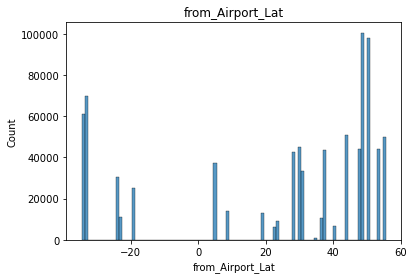

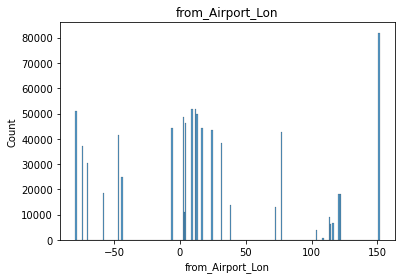

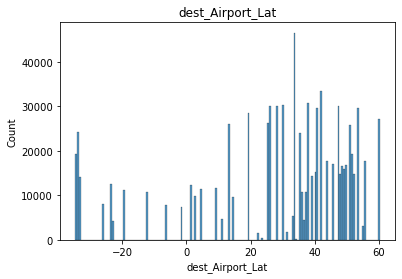

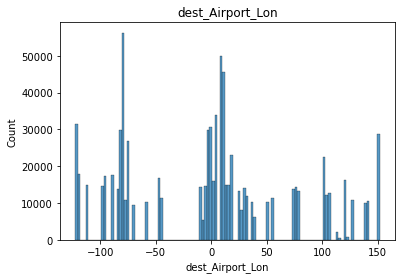

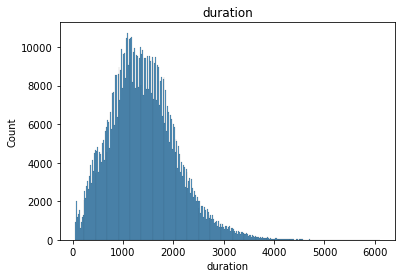

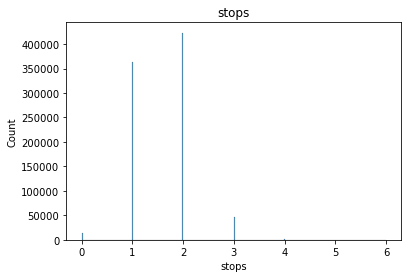

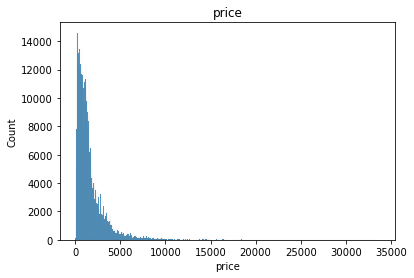

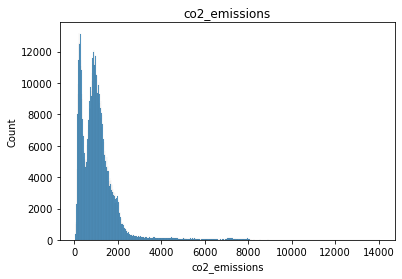

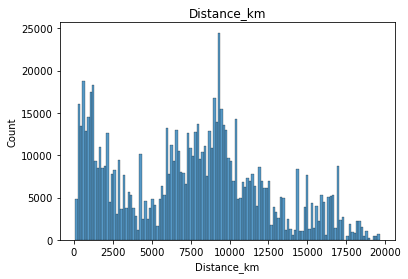

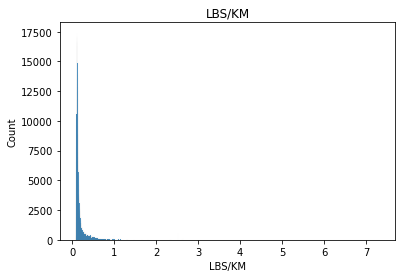

In [129]:
# Generate histograms for numeric columns
for column in df_clean.columns:
    sns.histplot(x=column, data=df_clean)
    plt.title(column)
    plt.show()

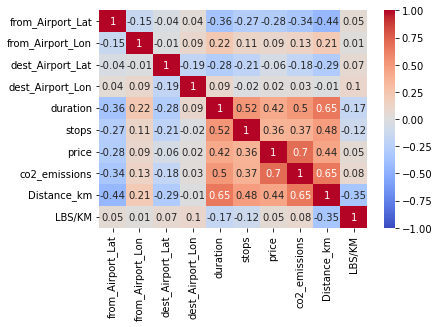

In [130]:
# Review Correlation 
sns.heatmap(df_clean.corr().round(2), vmin=-1, vmax=1, cmap='coolwarm', annot=True)
plt.show()

### Pre-Process Categorical Columns

In [131]:
categorical_col_list

['from_airport_code',
 'from_Airport_Name',
 'from_Airport_City',
 'from_country',
 'dest_airport_code',
 'dest_Airport_Name',
 'dest_Airport_City',
 'dest_country',
 'flight_number',
 'aircraft_type_1',
 'aircraft_type_2',
 'aircraft_type_3',
 'aircraft_type_4',
 'aircraft_type_5',
 'aircraft_type_6',
 'aircraft_type_7',
 'airline_1',
 'airline_2',
 'airline_3',
 'airline_4',
 'airline_5',
 'CO2_Classification',
 'from_airport_coordinates',
 'dest_airport_coordinates',
 'Route']

#### from_airport_code

In [132]:
# Check distribution of values
df2['from_airport_code'].value_counts(normalize=True)

FRA    0.061330
MUC    0.061013
YYZ    0.060048
CPH    0.058624
CDG    0.057546
BRU    0.054372
DUB    0.052309
VIE    0.052197
ATH    0.051386
SYD    0.050372
DEL    0.050346
MEL    0.046312
CAI    0.045279
BOG    0.044059
SCL    0.035980
GRU    0.035915
CNF    0.029440
AEP    0.021958
PVG    0.021379
ADD    0.016349
BOM    0.015390
SHA    0.013502
VCP    0.013021
ALG    0.012818
CAN    0.010546
HGH    0.007728
PEK    0.007692
SZX    0.007389
CTU    0.004690
XIY    0.001013
Name: from_airport_code, dtype: float64

In [133]:
# Instantiate the OneHotEncoder
ohe = OneHotEncoder()
subcategory = pd.DataFrame(df2['from_airport_code'])

# Fit the OneHotEncoder to the subcategory column and transform
encoded = ohe.fit_transform(subcategory)

# Convert from sparse matrix to dense
dense_array = encoded.toarray()

# Put into a dataframe to get column names
encoded_df = pd.DataFrame(dense_array, columns=ohe.categories_, dtype=int)

# add prefix
encoded_df.columns =[
    'from_airport_code_ADD'
    ,'from_airport_code_AEP'
    ,'from_airport_code_ALG'
    ,'from_airport_code_ATH'
    ,'from_airport_code_BOG'
    ,'from_airport_code_BOM'
    ,'from_airport_code_BRU'
    ,'from_airport_code_CAI'
    ,'from_airport_code_CAN'
    ,'from_airport_code_CDG'
    ,'from_airport_code_CNF'
    ,'from_airport_code_CPH'
    ,'from_airport_code_CTU'
    ,'from_airport_code_DEL'
    ,'from_airport_code_DUB'
    ,'from_airport_code_FRA'
    ,'from_airport_code_GRU'
    ,'from_airport_code_HGH'
    ,'from_airport_code_MEL'
    ,'from_airport_code_MUC'
    ,'from_airport_code_PEK'
    ,'from_airport_code_PVG'
    ,'from_airport_code_SCL'
    ,'from_airport_code_SHA'
    ,'from_airport_code_SYD'
    ,'from_airport_code_SZX'
    ,'from_airport_code_VCP'
    ,'from_airport_code_VIE'
    ,'from_airport_code_XIY'
    ,'from_airport_code_YYZ'
]



In [134]:
encoded_df

,from_airport_code_ADD,from_airport_code_AEP,from_airport_code_ALG,from_airport_code_ATH,from_airport_code_BOG,from_airport_code_BOM,from_airport_code_BRU,from_airport_code_CAI,from_airport_code_CAN,from_airport_code_CDG,from_airport_code_CNF,from_airport_code_CPH,from_airport_code_CTU,from_airport_code_DEL,from_airport_code_DUB,from_airport_code_FRA,from_airport_code_GRU,from_airport_code_HGH,from_airport_code_MEL,from_airport_code_MUC,from_airport_code_PEK,from_airport_code_PVG,from_airport_code_SCL,from_airport_code_SHA,from_airport_code_SYD,from_airport_code_SZX,from_airport_code_VCP,from_airport_code_VIE,from_airport_code_XIY,from_airport_code_YYZ
0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
847350,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
847351,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
847352,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
847353,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [135]:
# Combine Encoded Dataframe for Hotel_Country to df_clean
df_clean = pd.concat([df_clean, encoded_df], axis=1)

In [136]:
# Verify
df_clean.head()

,from_Airport_Lat,from_Airport_Lon,dest_Airport_Lat,dest_Airport_Lon,duration,stops,price,co2_emissions,Distance_km,LBS/KM,from_airport_code_ADD,from_airport_code_AEP,from_airport_code_ALG,from_airport_code_ATH,from_airport_code_BOG,from_airport_code_BOM,from_airport_code_BRU,from_airport_code_CAI,from_airport_code_CAN,from_airport_code_CDG,from_airport_code_CNF,from_airport_code_CPH,from_airport_code_CTU,from_airport_code_DEL,from_airport_code_DUB,from_airport_code_FRA,from_airport_code_GRU,from_airport_code_HGH,from_airport_code_MEL,from_airport_code_MUC,from_airport_code_PEK,from_airport_code_PVG,from_airport_code_SCL,from_airport_code_SHA,from_airport_code_SYD,from_airport_code_SZX,from_airport_code_VCP,from_airport_code_VIE,from_airport_code_XIY,from_airport_code_YYZ
0,36.698236,3.208053,-34.557739,-58.416644,1425,3,1279.0,1320.0,10167.91,0.129820,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,36.698236,3.208053,-34.557739,-58.416644,1425,3,1279.0,1195.0,10167.91,0.117527,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,36.698236,3.208053,-34.557739,-58.416644,1530,3,1284.0,1248.0,10167.91,0.122739,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,36.698236,3.208053,-34.557739,-58.416644,1425,3,1290.0,1347.0,10167.91,0.132476,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,36.698236,3.208053,-34.557739,-58.416644,1540,2,1347.0,1381.0,10167.91,0.135819,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [137]:
# Remove from categorical list
categorical_col_list.remove('from_airport_code')
categorical_col_list

['from_Airport_Name',
 'from_Airport_City',
 'from_country',
 'dest_airport_code',
 'dest_Airport_Name',
 'dest_Airport_City',
 'dest_country',
 'flight_number',
 'aircraft_type_1',
 'aircraft_type_2',
 'aircraft_type_3',
 'aircraft_type_4',
 'aircraft_type_5',
 'aircraft_type_6',
 'aircraft_type_7',
 'airline_1',
 'airline_2',
 'airline_3',
 'airline_4',
 'airline_5',
 'CO2_Classification',
 'from_airport_coordinates',
 'dest_airport_coordinates',
 'Route']

#### from_Airport_City

In [138]:
# Check distribution of values
df2['from_Airport_City'].value_counts(normalize=True)

Frankfurt       0.061330
Munich          0.061013
Toronto         0.060048
Copenhagen      0.058624
Paris           0.057546
Brussels        0.054372
Dublin          0.052309
Vienna          0.052197
Athens          0.051386
Sydney          0.050372
Delhi           0.050346
Sao Paulo       0.048936
Melbourne       0.046312
Cairo           0.045279
Bogota          0.044059
Santiago        0.035980
Shanghai        0.034881
Confins         0.029440
Buenos Aires    0.021958
Addis Ababa     0.016349
Mumbai          0.015390
Algiers         0.012818
Guangzhou       0.010546
Hangzhou        0.007728
Beijing         0.007692
Shenzhen        0.007389
Chengdu         0.004690
Xi'an           0.001013
Name: from_Airport_City, dtype: float64

In [139]:
# Instantiate the OneHotEncoder
ohe = OneHotEncoder()
subcategory = pd.DataFrame(df2['from_Airport_City'])

# Fit the OneHotEncoder to the subcategory column and transform
encoded = ohe.fit_transform(subcategory)

# Convert from sparse matrix to dense
dense_array = encoded.toarray()

# Put into a dataframe to get column names
encoded_df = pd.DataFrame(dense_array, columns=ohe.categories_, dtype=int)

# add prefix
encoded_df.columns = [
"from_Airport_City_Addis Ababa","from_Airport_City_Algiers"
    ,"from_Airport_City_Athens","from_Airport_City_Beijing"
    ,"from_Airport_City_Bogota","from_Airport_City_Brussels"
    ,"from_Airport_City_Buenos Aires","from_Airport_City_Cairo"
    ,"from_Airport_City_Chengdu","from_Airport_City_Confins"
    ,"from_Airport_City_Copenhagen","from_Airport_City_Delhi"
    ,"from_Airport_City_Dublin","from_Airport_City_Frankfurt"
    ,"from_Airport_City_Guangzhou","from_Airport_City_Hangzhou"
    ,"from_Airport_City_Melbourne","from_Airport_City_Mumbai"
    ,"from_Airport_City_Munich","from_Airport_City_Paris"
    ,"from_Airport_City_Santiago","from_Airport_City_Sao Paulo"
    ,"from_Airport_City_Shanghai","from_Airport_City_Shenzhen"
    ,"from_Airport_City_Sydney","from_Airport_City_Toronto"
    ,"from_Airport_City_Vienna","from_Airport_City_Xi'an"
]

In [140]:
encoded_df

,from_Airport_City_Addis Ababa,from_Airport_City_Algiers,from_Airport_City_Athens,from_Airport_City_Beijing,from_Airport_City_Bogota,from_Airport_City_Brussels,from_Airport_City_Buenos Aires,from_Airport_City_Cairo,from_Airport_City_Chengdu,from_Airport_City_Confins,from_Airport_City_Copenhagen,from_Airport_City_Delhi,from_Airport_City_Dublin,from_Airport_City_Frankfurt,from_Airport_City_Guangzhou,from_Airport_City_Hangzhou,from_Airport_City_Melbourne,from_Airport_City_Mumbai,from_Airport_City_Munich,from_Airport_City_Paris,from_Airport_City_Santiago,from_Airport_City_Sao Paulo,from_Airport_City_Shanghai,from_Airport_City_Shenzhen,from_Airport_City_Sydney,from_Airport_City_Toronto,from_Airport_City_Vienna,from_Airport_City_Xi'an
0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
847350,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
847351,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
847352,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0
847353,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0


In [141]:
# Combine Encoded Dataframe for Hotel_Country to df_clean
df_clean = pd.concat([df_clean, encoded_df], axis=1)

In [142]:
# Verify
df_clean.head()

,from_Airport_Lat,from_Airport_Lon,dest_Airport_Lat,dest_Airport_Lon,duration,stops,price,co2_emissions,Distance_km,LBS/KM,from_airport_code_ADD,from_airport_code_AEP,from_airport_code_ALG,from_airport_code_ATH,from_airport_code_BOG,from_airport_code_BOM,from_airport_code_BRU,from_airport_code_CAI,from_airport_code_CAN,from_airport_code_CDG,from_airport_code_CNF,from_airport_code_CPH,from_airport_code_CTU,from_airport_code_DEL,from_airport_code_DUB,from_airport_code_FRA,from_airport_code_GRU,from_airport_code_HGH,from_airport_code_MEL,from_airport_code_MUC,from_airport_code_PEK,from_airport_code_PVG,from_airport_code_SCL,from_airport_code_SHA,from_airport_code_SYD,from_airport_code_SZX,from_airport_code_VCP,from_airport_code_VIE,from_airport_code_XIY,from_airport_code_YYZ,from_Airport_City_Addis Ababa,from_Airport_City_Algiers,from_Airport_City_Athens,from_Airport_City_Beijing,from_Airport_City_Bogota,from_Airport_City_Brussels,from_Airport_City_Buenos Aires,from_Airport_City_Cairo,from_Airport_City_Chengdu,from_Airport_City_Confins,from_Airport_City_Copenhagen,from_Airport_City_Delhi,from_Airport_City_Dublin,from_Airport_City_Frankfurt,from_Airport_City_Guangzhou,from_Airport_City_Hangzhou,from_Airport_City_Melbourne,from_Airport_City_Mumbai,from_Airport_City_Munich,from_Airport_City_Paris,from_Airport_City_Santiago,from_Airport_City_Sao Paulo,from_Airport_City_Shanghai,from_Airport_City_Shenzhen,from_Airport_City_Sydney,from_Airport_City_Toronto,from_Airport_City_Vienna,from_Airport_City_Xi'an
0,36.698236,3.208053,-34.557739,-58.416644,1425,3,1279.0,1320.0,10167.91,0.129820,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,36.698236,3.208053,-34.557739,-58.416644,1425,3,1279.0,1195.0,10167.91,0.117527,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,36.698236,3.208053,-34.557739,-58.416644,1530,3,1284.0,1248.0,10167.91,0.122739,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,36.698236,3.208053,-34.557739,-58.416644,1425,3,1290.0,1347.0,10167.91,0.132476,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,36.698236,3.208053,-34.557739,-58.416644,1540,2,1347.0,1381.0,10167.91,0.135819,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [143]:
# Remove from categorical list
categorical_col_list.remove('from_Airport_City')
categorical_col_list

['from_Airport_Name',
 'from_country',
 'dest_airport_code',
 'dest_Airport_Name',
 'dest_Airport_City',
 'dest_country',
 'flight_number',
 'aircraft_type_1',
 'aircraft_type_2',
 'aircraft_type_3',
 'aircraft_type_4',
 'aircraft_type_5',
 'aircraft_type_6',
 'aircraft_type_7',
 'airline_1',
 'airline_2',
 'airline_3',
 'airline_4',
 'airline_5',
 'CO2_Classification',
 'from_airport_coordinates',
 'dest_airport_coordinates',
 'Route']

#### from_country

In [144]:
# Check distribution of values
df2['from_country'].value_counts(normalize=True)

Germany      0.122343
Australia    0.096684
Brazil       0.078376
China        0.073938
India        0.065736
Canada       0.060048
Denmark      0.058624
France       0.057546
Belgium      0.054372
Dublin       0.052309
Austria      0.052197
Greece       0.051386
Egypt        0.045279
Columbia     0.044059
Chile        0.035980
Argentina    0.021958
Ethiopia     0.016349
Algeria      0.012818
Name: from_country, dtype: float64

In [145]:
# Instantiate the OneHotEncoder
ohe = OneHotEncoder()
subcategory = pd.DataFrame(df2['from_country'])

# Fit the OneHotEncoder to the subcategory column and transform
encoded = ohe.fit_transform(subcategory)

# Convert from sparse matrix to dense
dense_array = encoded.toarray()

# Put into a dataframe to get column names
encoded_df = pd.DataFrame(dense_array, columns=ohe.categories_, dtype=int)

# add prefix
encoded_df.columns = ["from_country_Algeria","from_country_Argentina"
                      ,"from_country_Australia","from_country_Austria"
                      ,"from_country_Belgium","from_country_Brazil"
                      ,"from_country_Canada","from_country_Chile"
                      ,"from_country_China","from_country_Columbia"
                      ,"from_country_Denmark","from_country_Dublin"
                      ,"from_country_Egypt","from_country_Ethiopia"
                      ,"from_country_France","from_country_Germany"
                      ,"from_country_Greece","from_country_India",]

In [146]:
# Combine Encoded Dataframe for Hotel_Country to df_clean
df_clean = pd.concat([df_clean, encoded_df], axis=1)

In [147]:
# Verify
df_clean.head()

,from_Airport_Lat,from_Airport_Lon,dest_Airport_Lat,dest_Airport_Lon,duration,stops,price,co2_emissions,Distance_km,LBS/KM,from_airport_code_ADD,from_airport_code_AEP,from_airport_code_ALG,from_airport_code_ATH,from_airport_code_BOG,from_airport_code_BOM,from_airport_code_BRU,from_airport_code_CAI,from_airport_code_CAN,from_airport_code_CDG,from_airport_code_CNF,from_airport_code_CPH,from_airport_code_CTU,from_airport_code_DEL,from_airport_code_DUB,from_airport_code_FRA,from_airport_code_GRU,from_airport_code_HGH,from_airport_code_MEL,from_airport_code_MUC,from_airport_code_PEK,from_airport_code_PVG,from_airport_code_SCL,from_airport_code_SHA,from_airport_code_SYD,from_airport_code_SZX,from_airport_code_VCP,from_airport_code_VIE,from_airport_code_XIY,from_airport_code_YYZ,from_Airport_City_Addis Ababa,from_Airport_City_Algiers,from_Airport_City_Athens,from_Airport_City_Beijing,from_Airport_City_Bogota,from_Airport_City_Brussels,from_Airport_City_Buenos Aires,from_Airport_City_Cairo,from_Airport_City_Chengdu,from_Airport_City_Confins,from_Airport_City_Copenhagen,from_Airport_City_Delhi,from_Airport_City_Dublin,from_Airport_City_Frankfurt,from_Airport_City_Guangzhou,from_Airport_City_Hangzhou,from_Airport_City_Melbourne,from_Airport_City_Mumbai,from_Airport_City_Munich,from_Airport_City_Paris,from_Airport_City_Santiago,from_Airport_City_Sao Paulo,from_Airport_City_Shanghai,from_Airport_City_Shenzhen,from_Airport_City_Sydney,from_Airport_City_Toronto,from_Airport_City_Vienna,from_Airport_City_Xi'an,from_country_Algeria,from_country_Argentina,from_country_Australia,from_country_Austria,from_country_Belgium,from_country_Brazil,from_country_Canada,from_country_Chile,from_country_China,from_country_Columbia,from_country_Denmark,from_country_Dublin,from_country_Egypt,from_country_Ethiopia,from_country_France,from_country_Germany,from_country_Greece,from_country_India
0,36.698236,3.208053,-34.557739,-58.416644,1425,3,1279.0,1320.0,10167.91,0.129820,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,36.698236,3.208053,-34.557739,-58.416644,1425,3,1279.0,1195.0,10167.91,0.117527,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,36.698236,3.208053,-34.557739,-58.416644,1530,3,1284.0,1248.0,10167.91,0.122739,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,36.698236,3.208053,-34.557739,-58.416644,1425,3,1290.0,1347.0,10167.91,0.132476,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,36.698236,3.208053,-34.557739,-58.416644,1540,2,1347.0,1381.0,10167.91,0.135819,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [148]:
# Remove from categorical list
categorical_col_list.remove('from_country')
categorical_col_list

['from_Airport_Name',
 'dest_airport_code',
 'dest_Airport_Name',
 'dest_Airport_City',
 'dest_country',
 'flight_number',
 'aircraft_type_1',
 'aircraft_type_2',
 'aircraft_type_3',
 'aircraft_type_4',
 'aircraft_type_5',
 'aircraft_type_6',
 'aircraft_type_7',
 'airline_1',
 'airline_2',
 'airline_3',
 'airline_4',
 'airline_5',
 'CO2_Classification',
 'from_airport_coordinates',
 'dest_airport_coordinates',
 'Route']

#### dest_airport_code

In [149]:
# Check distribution of values
df2['dest_airport_code'].value_counts(normalize=True)

LHR    0.022807
YYZ    0.020965
LAX    0.020965
ORD    0.020896
SFO    0.020669
         ...   
HGH    0.001004
CAN    0.000523
PEK    0.000469
XIY    0.000118
CTU    0.000001
Name: dest_airport_code, Length: 77, dtype: float64

In [150]:
# Instantiate the OneHotEncoder
ohe = OneHotEncoder()
subcategory = pd.DataFrame(df2['dest_airport_code'])

# Fit the OneHotEncoder to the subcategory column and transform
encoded = ohe.fit_transform(subcategory)

# Convert from sparse matrix to dense
dense_array = encoded.toarray()

# Put into a dataframe to get column names
encoded_df = pd.DataFrame(dense_array, columns=ohe.categories_, dtype=int)

# add prefix
encoded_df.columns =['dest_airport_code_ADD','dest_airport_code_AEP',
                     'dest_airport_code_ALG','dest_airport_code_AMS',
                     'dest_airport_code_ARN','dest_airport_code_ATH',
                     'dest_airport_code_ATL','dest_airport_code_BKK',
                     'dest_airport_code_BLR','dest_airport_code_BOG',
                     'dest_airport_code_BOM','dest_airport_code_BRU',
                     'dest_airport_code_CAI','dest_airport_code_CAN',
                     'dest_airport_code_CDG','dest_airport_code_CGK',
                     'dest_airport_code_CLT','dest_airport_code_CMN',
                     'dest_airport_code_CNF','dest_airport_code_CPH',
                     'dest_airport_code_CPT','dest_airport_code_CTU',
                     'dest_airport_code_DEL','dest_airport_code_DME',
                     'dest_airport_code_DOH','dest_airport_code_DUB',
                     'dest_airport_code_DXB','dest_airport_code_FCO',
                     'dest_airport_code_FLL','dest_airport_code_FRA',
                     'dest_airport_code_GRU','dest_airport_code_HGH',
                     'dest_airport_code_HND','dest_airport_code_IAH',
                     'dest_airport_code_ICN','dest_airport_code_IST',
                     'dest_airport_code_JFK','dest_airport_code_JNB',
                     'dest_airport_code_KUL','dest_airport_code_LAX',
                     'dest_airport_code_LGW','dest_airport_code_LHR',
                     'dest_airport_code_LIM','dest_airport_code_LIS',
                     'dest_airport_code_MAD','dest_airport_code_MAN',
                     'dest_airport_code_MCO','dest_airport_code_MEL',
                     'dest_airport_code_MEX','dest_airport_code_MIA',
                     'dest_airport_code_MNL','dest_airport_code_MUC',
                     'dest_airport_code_MXP','dest_airport_code_NBO',
                     'dest_airport_code_NRT','dest_airport_code_ORD',
                     'dest_airport_code_OSL','dest_airport_code_PEK',
                     'dest_airport_code_PHX','dest_airport_code_PTY',
                     'dest_airport_code_PVG','dest_airport_code_SAW',
                     'dest_airport_code_SCL','dest_airport_code_SEA',
                     'dest_airport_code_SFO','dest_airport_code_SGN',
                     'dest_airport_code_SHA','dest_airport_code_SIN',
                     'dest_airport_code_SVO','dest_airport_code_SYD',
                     'dest_airport_code_SZX','dest_airport_code_TPE',
                     'dest_airport_code_VCP','dest_airport_code_VIE',
                     'dest_airport_code_XIY','dest_airport_code_YYZ',
                     'dest_airport_code_ZRH']

In [151]:
encoded_df

,dest_airport_code_ADD,dest_airport_code_AEP,dest_airport_code_ALG,dest_airport_code_AMS,dest_airport_code_ARN,dest_airport_code_ATH,dest_airport_code_ATL,dest_airport_code_BKK,dest_airport_code_BLR,dest_airport_code_BOG,dest_airport_code_BOM,dest_airport_code_BRU,dest_airport_code_CAI,dest_airport_code_CAN,dest_airport_code_CDG,dest_airport_code_CGK,dest_airport_code_CLT,dest_airport_code_CMN,dest_airport_code_CNF,dest_airport_code_CPH,dest_airport_code_CPT,dest_airport_code_CTU,dest_airport_code_DEL,dest_airport_code_DME,dest_airport_code_DOH,dest_airport_code_DUB,dest_airport_code_DXB,dest_airport_code_FCO,dest_airport_code_FLL,dest_airport_code_FRA,dest_airport_code_GRU,dest_airport_code_HGH,dest_airport_code_HND,dest_airport_code_IAH,dest_airport_code_ICN,dest_airport_code_IST,dest_airport_code_JFK,dest_airport_code_JNB,dest_airport_code_KUL,dest_airport_code_LAX,dest_airport_code_LGW,dest_airport_code_LHR,dest_airport_code_LIM,dest_airport_code_LIS,dest_airport_code_MAD,dest_airport_code_MAN,dest_airport_code_MCO,dest_airport_code_MEL,dest_airport_code_MEX,dest_airport_code_MIA,dest_airport_code_MNL,dest_airport_code_MUC,dest_airport_code_MXP,dest_airport_code_NBO,dest_airport_code_NRT,dest_airport_code_ORD,dest_airport_code_OSL,dest_airport_code_PEK,dest_airport_code_PHX,dest_airport_code_PTY,dest_airport_code_PVG,dest_airport_code_SAW,dest_airport_code_SCL,dest_airport_code_SEA,dest_airport_code_SFO,dest_airport_code_SGN,dest_airport_code_SHA,dest_airport_code_SIN,dest_airport_code_SVO,dest_airport_code_SYD,dest_airport_code_SZX,dest_airport_code_TPE,dest_airport_code_VCP,dest_airport_code_VIE,dest_airport_code_XIY,dest_airport_code_YYZ,dest_airport_code_ZRH
0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
847350,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
847351,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
847352,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0
847353,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0


In [152]:
# Combine Encoded Dataframe for Hotel_Country to df_clean
df_clean = pd.concat([df_clean, encoded_df], axis=1)

In [153]:
# Verify
df_clean.head()

,from_Airport_Lat,from_Airport_Lon,dest_Airport_Lat,dest_Airport_Lon,duration,stops,price,co2_emissions,Distance_km,LBS/KM,from_airport_code_ADD,from_airport_code_AEP,from_airport_code_ALG,from_airport_code_ATH,from_airport_code_BOG,from_airport_code_BOM,from_airport_code_BRU,from_airport_code_CAI,from_airport_code_CAN,from_airport_code_CDG,from_airport_code_CNF,from_airport_code_CPH,from_airport_code_CTU,from_airport_code_DEL,from_airport_code_DUB,from_airport_code_FRA,from_airport_code_GRU,from_airport_code_HGH,from_airport_code_MEL,from_airport_code_MUC,from_airport_code_PEK,from_airport_code_PVG,from_airport_code_SCL,from_airport_code_SHA,from_airport_code_SYD,from_airport_code_SZX,from_airport_code_VCP,from_airport_code_VIE,from_airport_code_XIY,from_airport_code_YYZ,from_Airport_City_Addis Ababa,from_Airport_City_Algiers,from_Airport_City_Athens,from_Airport_City_Beijing,from_Airport_City_Bogota,from_Airport_City_Brussels,from_Airport_City_Buenos Aires,from_Airport_City_Cairo,from_Airport_City_Chengdu,from_Airport_City_Confins,from_Airport_City_Copenhagen,from_Airport_City_Delhi,from_Airport_City_Dublin,from_Airport_City_Frankfurt,from_Airport_City_Guangzhou,from_Airport_City_Hangzhou,from_Airport_City_Melbourne,from_Airport_City_Mumbai,from_Airport_City_Munich,from_Airport_City_Paris,from_Airport_City_Santiago,from_Airport_City_Sao Paulo,from_Airport_City_Shanghai,from_Airport_City_Shenzhen,from_Airport_City_Sydney,from_Airport_City_Toronto,from_Airport_City_Vienna,from_Airport_City_Xi'an,from_country_Algeria,from_country_Argentina,from_country_Australia,from_country_Austria,from_country_Belgium,from_country_Brazil,from_country_Canada,from_country_Chile,from_country_China,from_country_Columbia,from_country_Denmark,from_country_Dublin,from_country_Egypt,from_country_Ethiopia,from_country_France,from_country_Germany,from_country_Greece,from_country_India,dest_airport_code_ADD,dest_airport_code_AEP,dest_airport_code_ALG,dest_airport_code_AMS,dest_airport_code_ARN,dest_airport_code_ATH,dest_airport_code_ATL,dest_airport_code_BKK,dest_airport_code_BLR,dest_airport_code_BOG,dest_airport_code_BOM,dest_airport_code_BRU,dest_airport_code_CAI,dest_airport_code_CAN,dest_airport_code_CDG,dest_airport_code_CGK,dest_airport_code_CLT,dest_airport_code_CMN,dest_airport_code_CNF,dest_airport_code_CPH,dest_airport_code_CPT,dest_airport_code_CTU,dest_airport_code_DEL,dest_airport_code_DME,dest_airport_code_DOH,dest_airport_code_DUB,dest_airport_code_DXB,dest_airport_code_FCO,dest_airport_code_FLL,dest_airport_code_FRA,dest_airport_code_GRU,dest_airport_code_HGH,dest_airport_code_HND,dest_airport_code_IAH,dest_airport_code_ICN,dest_airport_code_IST,dest_airport_code_JFK,dest_airport_code_JNB,dest_airport_code_KUL,dest_airport_code_LAX,dest_airport_code_LGW,dest_airport_code_LHR,dest_airport_code_LIM,dest_airport_code_LIS,dest_airport_code_MAD,dest_airport_code_MAN,dest_airport_code_MCO,dest_airport_code_MEL,dest_airport_code_MEX,dest_airport_code_MIA,dest_airport_code_MNL,dest_airport_code_MUC,dest_airport_code_MXP,dest_airport_code_NBO,dest_airport_code_NRT,dest_airport_code_ORD,dest_airport_code_OSL,dest_airport_code_PEK,dest_airport_code_PHX,dest_airport_code_PTY,dest_airport_code_PVG,dest_airport_code_SAW,dest_airport_code_SCL,dest_airport_code_SEA,dest_airport_code_SFO,dest_airport_code_SGN,dest_airport_code_SHA,dest_airport_code_SIN,dest_airport_code_SVO,dest_airport_code_SYD,dest_airport_code_SZX,dest_airport_code_TPE,dest_airport_code_VCP,dest_airport_code_VIE,dest_airport_code_XIY,dest_airport_code_YYZ,dest_airport_code_ZRH
0,36.698236,3.208053,-34.557739,-58.416644,1425,3,1279.0,1320.0,10167.91,0.129820,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,36.698236,3.208053,-34.5

In [154]:
# Remove from categorical list
categorical_col_list.remove('dest_airport_code')
categorical_col_list

['from_Airport_Name',
 'dest_Airport_Name',
 'dest_Airport_City',
 'dest_country',
 'flight_number',
 'aircraft_type_1',
 'aircraft_type_2',
 'aircraft_type_3',
 'aircraft_type_4',
 'aircraft_type_5',
 'aircraft_type_6',
 'aircraft_type_7',
 'airline_1',
 'airline_2',
 'airline_3',
 'airline_4',
 'airline_5',
 'CO2_Classification',
 'from_airport_coordinates',
 'dest_airport_coordinates',
 'Route']

#### dest_Airport_City

In [155]:
# Check distribution of values
df2['dest_Airport_City'].value_counts(normalize=True)

London         0.036269
Miami          0.035395
Tokyo          0.024345
Los Angeles    0.020965
Toronto        0.020965
                 ...   
Hangzhou       0.001004
Guangzhou      0.000523
Beijing        0.000469
Xi'an          0.000118
Chengdu        0.000001
Name: dest_Airport_City, Length: 70, dtype: float64

In [156]:
# Instantiate the OneHotEncoder
ohe = OneHotEncoder()
subcategory = pd.DataFrame(df2['dest_Airport_City'])

# Fit the OneHotEncoder to the subcategory column and transform
encoded = ohe.fit_transform(subcategory)

# Convert from sparse matrix to dense
dense_array = encoded.toarray()

# Put into a dataframe to get column names
encoded_df = pd.DataFrame(dense_array, columns=ohe.categories_, dtype=int)

# add prefix
encoded_df.columns = [
    "dest_Airport_City_Addis Ababa","dest_Airport_City_Algiers"
    ,"dest_Airport_City_Amsterdam","dest_Airport_City_Athens"
    ,"dest_Airport_City_Atlanta","dest_Airport_City_Bangalore"
    ,"dest_Airport_City_Bangkok","dest_Airport_City_Beijing"
    ,"dest_Airport_City_Bogota","dest_Airport_City_Brussels"
    ,"dest_Airport_City_Buenos Aires","dest_Airport_City_Cairo"
    ,"dest_Airport_City_Cape Town","dest_Airport_City_Casablanca"
    ,"dest_Airport_City_Charlotte","dest_Airport_City_Chengdu"
    ,"dest_Airport_City_Chicago","dest_Airport_City_Confins"
    ,"dest_Airport_City_Copenhagen","dest_Airport_City_Delhi"
    ,"dest_Airport_City_Doha","dest_Airport_City_Dubai"
    ,"dest_Airport_City_Dublin","dest_Airport_City_Fiumicino"
    ,"dest_Airport_City_Frankfurt","dest_Airport_City_Guangzhou"
    ,"dest_Airport_City_Hangzhou","dest_Airport_City_Ho Chi Minh City"
    ,"dest_Airport_City_Houston","dest_Airport_City_Istanbul"
    ,"dest_Airport_City_Jakarta","dest_Airport_City_Johannesburg"
    ,"dest_Airport_City_Kuala Lumpur","dest_Airport_City_Lima"
    ,"dest_Airport_City_Lisbon","dest_Airport_City_London"
    ,"dest_Airport_City_Los Angeles","dest_Airport_City_Madrid"
    ,"dest_Airport_City_Manchester","dest_Airport_City_Manila"
    ,"dest_Airport_City_Melbourne","dest_Airport_City_Mexico City"
    ,"dest_Airport_City_Miami","dest_Airport_City_Milan"
    ,"dest_Airport_City_Moscow","dest_Airport_City_Mumbai"
    ,"dest_Airport_City_Munich","dest_Airport_City_Nairobi"
    ,"dest_Airport_City_New York","dest_Airport_City_Orlando"
    ,"dest_Airport_City_Oslo","dest_Airport_City_Panama City"
    ,"dest_Airport_City_Paris","dest_Airport_City_Phoenix"
    ,"dest_Airport_City_San Francisco","dest_Airport_City_Santiago"
    ,"dest_Airport_City_Sao Paulo","dest_Airport_City_Seattle"
    ,"dest_Airport_City_Seoul","dest_Airport_City_Shanghai"
    ,"dest_Airport_City_Shenzhen","dest_Airport_City_Singapore"
    ,"dest_Airport_City_Stockholm","dest_Airport_City_Sydney"
    ,"dest_Airport_City_Taipei","dest_Airport_City_Tokyo"
    ,"dest_Airport_City_Toronto","dest_Airport_City_Vienna"
    ,"dest_Airport_City_Xi'an","dest_Airport_City_Zurich"
]

In [157]:
encoded_df

,dest_Airport_City_Addis Ababa,dest_Airport_City_Algiers,dest_Airport_City_Amsterdam,dest_Airport_City_Athens,dest_Airport_City_Atlanta,dest_Airport_City_Bangalore,dest_Airport_City_Bangkok,dest_Airport_City_Beijing,dest_Airport_City_Bogota,dest_Airport_City_Brussels,dest_Airport_City_Buenos Aires,dest_Airport_City_Cairo,dest_Airport_City_Cape Town,dest_Airport_City_Casablanca,dest_Airport_City_Charlotte,dest_Airport_City_Chengdu,dest_Airport_City_Chicago,dest_Airport_City_Confins,dest_Airport_City_Copenhagen,dest_Airport_City_Delhi,dest_Airport_City_Doha,dest_Airport_City_Dubai,dest_Airport_City_Dublin,dest_Airport_City_Fiumicino,dest_Airport_City_Frankfurt,dest_Airport_City_Guangzhou,dest_Airport_City_Hangzhou,dest_Airport_City_Ho Chi Minh City,dest_Airport_City_Houston,dest_Airport_City_Istanbul,dest_Airport_City_Jakarta,dest_Airport_City_Johannesburg,dest_Airport_City_Kuala Lumpur,dest_Airport_City_Lima,dest_Airport_City_Lisbon,dest_Airport_City_London,dest_Airport_City_Los Angeles,dest_Airport_City_Madrid,dest_Airport_City_Manchester,dest_Airport_City_Manila,dest_Airport_City_Melbourne,dest_Airport_City_Mexico City,dest_Airport_City_Miami,dest_Airport_City_Milan,dest_Airport_City_Moscow,dest_Airport_City_Mumbai,dest_Airport_City_Munich,dest_Airport_City_Nairobi,dest_Airport_City_New York,dest_Airport_City_Orlando,dest_Airport_City_Oslo,dest_Airport_City_Panama City,dest_Airport_City_Paris,dest_Airport_City_Phoenix,dest_Airport_City_San Francisco,dest_Airport_City_Santiago,dest_Airport_City_Sao Paulo,dest_Airport_City_Seattle,dest_Airport_City_Seoul,dest_Airport_City_Shanghai,dest_Airport_City_Shenzhen,dest_Airport_City_Singapore,dest_Airport_City_Stockholm,dest_Airport_City_Sydney,dest_Airport_City_Taipei,dest_Airport_City_Tokyo,dest_Airport_City_Toronto,dest_Airport_City_Vienna,dest_Airport_City_Xi'an,dest_Airport_City_Zurich
0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
847350,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
847351,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
847352,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0
847353,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,1,0,0,0,0,0,0


In [158]:
# Combine Encoded Dataframe for Hotel_Country to df_clean
df_clean = pd.concat([df_clean, encoded_df], axis=1)

In [159]:
# Verify
df_clean.head()

,from_Airport_Lat,from_Airport_Lon,dest_Airport_Lat,dest_Airport_Lon,duration,stops,price,co2_emissions,Distance_km,LBS/KM,from_airport_code_ADD,from_airport_code_AEP,from_airport_code_ALG,from_airport_code_ATH,from_airport_code_BOG,from_airport_code_BOM,from_airport_code_BRU,from_airport_code_CAI,from_airport_code_CAN,from_airport_code_CDG,from_airport_code_CNF,from_airport_code_CPH,from_airport_code_CTU,from_airport_code_DEL,from_airport_code_DUB,from_airport_code_FRA,from_airport_code_GRU,from_airport_code_HGH,from_airport_code_MEL,from_airport_code_MUC,from_airport_code_PEK,from_airport_code_PVG,from_airport_code_SCL,from_airport_code_SHA,from_airport_code_SYD,from_airport_code_SZX,from_airport_code_VCP,from_airport_code_VIE,from_airport_code_XIY,from_airport_code_YYZ,from_Airport_City_Addis Ababa,from_Airport_City_Algiers,from_Airport_City_Athens,from_Airport_City_Beijing,from_Airport_City_Bogota,from_Airport_City_Brussels,from_Airport_City_Buenos Aires,from_Airport_City_Cairo,from_Airport_City_Chengdu,from_Airport_City_Confins,from_Airport_City_Copenhagen,from_Airport_City_Delhi,from_Airport_City_Dublin,from_Airport_City_Frankfurt,from_Airport_City_Guangzhou,from_Airport_City_Hangzhou,from_Airport_City_Melbourne,from_Airport_City_Mumbai,from_Airport_City_Munich,from_Airport_City_Paris,from_Airport_City_Santiago,from_Airport_City_Sao Paulo,from_Airport_City_Shanghai,from_Airport_City_Shenzhen,from_Airport_City_Sydney,from_Airport_City_Toronto,from_Airport_City_Vienna,from_Airport_City_Xi'an,from_country_Algeria,from_country_Argentina,from_country_Australia,from_country_Austria,from_country_Belgium,from_country_Brazil,from_country_Canada,from_country_Chile,from_country_China,from_country_Columbia,from_country_Denmark,from_country_Dublin,from_country_Egypt,from_country_Ethiopia,from_country_France,from_country_Germany,from_country_Greece,from_country_India,dest_airport_code_ADD,dest_airport_code_AEP,dest_airport_code_ALG,dest_airport_code_AMS,dest_airport_code_ARN,dest_airport_code_ATH,dest_airport_code_ATL,dest_airport_code_BKK,dest_airport_code_BLR,dest_airport_code_BOG,dest_airport_code_BOM,dest_airport_code_BRU,dest_airport_code_CAI,dest_airport_code_CAN,dest_airport_code_CDG,dest_airport_code_CGK,dest_airport_code_CLT,dest_airport_code_CMN,dest_airport_code_CNF,dest_airport_code_CPH,dest_airport_code_CPT,dest_airport_code_CTU,dest_airport_code_DEL,dest_airport_code_DME,dest_airport_code_DOH,dest_airport_code_DUB,dest_airport_code_DXB,dest_airport_code_FCO,dest_airport_code_FLL,dest_airport_code_FRA,dest_airport_code_GRU,dest_airport_code_HGH,dest_airport_code_HND,dest_airport_code_IAH,dest_airport_code_ICN,dest_airport_code_IST,dest_airport_code_JFK,dest_airport_code_JNB,dest_airport_code_KUL,dest_airport_code_LAX,dest_airport_code_LGW,dest_airport_code_LHR,dest_airport_code_LIM,dest_airport_code_LIS,dest_airport_code_MAD,dest_airport_code_MAN,dest_airport_code_MCO,dest_airport_code_MEL,dest_airport_code_MEX,dest_airport_code_MIA,dest_airport_code_MNL,dest_airport_code_MUC,dest_airport_code_MXP,dest_airport_code_NBO,dest_airport_code_NRT,dest_airport_code_ORD,dest_airport_code_OSL,dest_airport_code_PEK,dest_airport_code_PHX,dest_airport_code_PTY,dest_airport_code_PVG,dest_airport_code_SAW,dest_airport_code_SCL,dest_airport_code_SEA,dest_airport_code_SFO,dest_airport_code_SGN,dest_airport_code_SHA,dest_airport_code_SIN,dest_airport_code_SVO,dest_airport_code_SYD,dest_airport_code_SZX,dest_airport_code_TPE,dest_airport_code_VCP,dest_airport_code_VIE,dest_airport_code_XIY,dest_airport_code_YYZ,dest_airport_code_ZRH,dest_Airport_City_Addis Ababa,dest_Airport_City_Algiers,dest_Airport_City_Amsterdam,dest_Airport_City_Athens,dest_Airport_City_Atlanta,dest_Airport_City_Bangalore,dest_Airport_City_Bangkok,dest_Airport_City_Beijing,dest_Airport_City_Bogota,dest_Airport_City_Brussels,dest_Airport_City_Buenos Aires,dest_Airport_City_Cairo,dest_Airport_City_Cape Town,dest_Airport_City_Casablanca,dest_Airport_City_Charlotte,dest_Ai

In [160]:
# Remove from categorical list
categorical_col_list.remove('dest_Airport_City')
categorical_col_list

['from_Airport_Name',
 'dest_Airport_Name',
 'dest_country',
 'flight_number',
 'aircraft_type_1',
 'aircraft_type_2',
 'aircraft_type_3',
 'aircraft_type_4',
 'aircraft_type_5',
 'aircraft_type_6',
 'aircraft_type_7',
 'airline_1',
 'airline_2',
 'airline_3',
 'airline_4',
 'airline_5',
 'CO2_Classification',
 'from_airport_coordinates',
 'dest_airport_coordinates',
 'Route']

#### dest_country

In [161]:
# Check distribution of values
df2['dest_country'].value_counts(normalize=True)

United States           0.222522
United Kingdom          0.053943
India                   0.049103
Germany                 0.039354
Australia               0.034053
Brazil                  0.033235
Japan                   0.024345
Canada                  0.020965
South Africa            0.020252
Italy                   0.020184
Zurich                  0.018906
France                  0.018819
Rome                    0.018525
Denmark                 0.017693
Austria                 0.017544
Netherlands             0.017506
Spain                   0.017473
Mexico                  0.017396
Dublin                  0.017394
Belgium                 0.017143
Portugal                0.016863
Turkey                  0.016773
Sweden                  0.016481
Norway                  0.015592
Greece                  0.015508
Thailand                0.014955
Singapore               0.014524
Egypt                   0.014064
Columbia                0.013483
United Arab Emirates    0.013408
Peru      

In [162]:
# Instantiate the OneHotEncoder
ohe = OneHotEncoder()
subcategory = pd.DataFrame(df2['dest_country'])

# Fit the OneHotEncoder to the subcategory column and transform
encoded = ohe.fit_transform(subcategory)

# Convert from sparse matrix to dense
dense_array = encoded.toarray()

# Put into a dataframe to get column names
encoded_df = pd.DataFrame(dense_array, columns=ohe.categories_, dtype=int)

# add prefix
encoded_df.columns = [
    "dest_Airport_City_Algeria","dest_Airport_City_Argentina"
    ,"dest_Airport_City_Australia","dest_Airport_City_Austria"
    ,"dest_Airport_City_Belgium","dest_Airport_City_Brazil"
    ,"dest_Airport_City_Canada","dest_Airport_City_Chile"
    ,"dest_Airport_City_China","dest_Airport_City_Columbia"
    ,"dest_Airport_City_Denmark","dest_Airport_City_Dublin"
    ,"dest_Airport_City_Egypt","dest_Airport_City_Ethiopia"
    ,"dest_Airport_City_France","dest_Airport_City_Germany"
    ,"dest_Airport_City_Greece","dest_Airport_City_India"
    ,"dest_Airport_City_Indonesia","dest_Airport_City_Italy"
    ,"dest_Airport_City_Japan","dest_Airport_City_Kenya"
    ,"dest_Airport_City_Malaysia","dest_Airport_City_Mexico"
    ,"dest_Airport_City_Morocco","dest_Airport_City_Netherlands"
    ,"dest_Airport_City_Norway","dest_Airport_City_Panama"
    ,"dest_Airport_City_Peru","dest_Airport_City_Philippines"
    ,"dest_Airport_City_Portugal","dest_Airport_City_Qatar"
    ,"dest_Airport_City_Rome","dest_Airport_City_Russia"
    ,"dest_Airport_City_Singapore","dest_Airport_City_South Africa"
    ,"dest_Airport_City_South Korea","dest_Airport_City_Spain"
    ,"dest_Airport_City_Sweden","dest_Airport_City_Taiwan"
    ,"dest_Airport_City_Thailand","dest_Airport_City_Turkey"
    ,"dest_Airport_City_United Arab Emirates","dest_Airport_City_United Kingdom"
    ,"dest_Airport_City_United States","dest_Airport_City_Vietnam"
    ,"dest_Airport_City_Zurich"
]

In [163]:
encoded_df

,dest_Airport_City_Algeria,dest_Airport_City_Argentina,dest_Airport_City_Australia,dest_Airport_City_Austria,dest_Airport_City_Belgium,dest_Airport_City_Brazil,dest_Airport_City_Canada,dest_Airport_City_Chile,dest_Airport_City_China,dest_Airport_City_Columbia,dest_Airport_City_Denmark,dest_Airport_City_Dublin,dest_Airport_City_Egypt,dest_Airport_City_Ethiopia,dest_Airport_City_France,dest_Airport_City_Germany,dest_Airport_City_Greece,dest_Airport_City_India,dest_Airport_City_Indonesia,dest_Airport_City_Italy,dest_Airport_City_Japan,dest_Airport_City_Kenya,dest_Airport_City_Malaysia,dest_Airport_City_Mexico,dest_Airport_City_Morocco,dest_Airport_City_Netherlands,dest_Airport_City_Norway,dest_Airport_City_Panama,dest_Airport_City_Peru,dest_Airport_City_Philippines,dest_Airport_City_Portugal,dest_Airport_City_Qatar,dest_Airport_City_Rome,dest_Airport_City_Russia,dest_Airport_City_Singapore,dest_Airport_City_South Africa,dest_Airport_City_South Korea,dest_Airport_City_Spain,dest_Airport_City_Sweden,dest_Airport_City_Taiwan,dest_Airport_City_Thailand,dest_Airport_City_Turkey,dest_Airport_City_United Arab Emirates,dest_Airport_City_United Kingdom,dest_Airport_City_United States,dest_Airport_City_Vietnam,dest_Airport_City_Zurich
0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
1,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
2,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
3,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
4,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...,...
847350,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
847351,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
847352,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0
847353,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0


In [164]:
# Combine Encoded Dataframe for Hotel_Country to df_clean
df_clean = pd.concat([df_clean, encoded_df], axis=1)

In [165]:
# Verify
df_clean.head()

,from_Airport_Lat,from_Airport_Lon,dest_Airport_Lat,dest_Airport_Lon,duration,stops,price,co2_emissions,Distance_km,LBS/KM,from_airport_code_ADD,from_airport_code_AEP,from_airport_code_ALG,from_airport_code_ATH,from_airport_code_BOG,from_airport_code_BOM,from_airport_code_BRU,from_airport_code_CAI,from_airport_code_CAN,from_airport_code_CDG,from_airport_code_CNF,from_airport_code_CPH,from_airport_code_CTU,from_airport_code_DEL,from_airport_code_DUB,from_airport_code_FRA,from_airport_code_GRU,from_airport_code_HGH,from_airport_code_MEL,from_airport_code_MUC,from_airport_code_PEK,from_airport_code_PVG,from_airport_code_SCL,from_airport_code_SHA,from_airport_code_SYD,from_airport_code_SZX,from_airport_code_VCP,from_airport_code_VIE,from_airport_code_XIY,from_airport_code_YYZ,from_Airport_City_Addis Ababa,from_Airport_City_Algiers,from_Airport_City_Athens,from_Airport_City_Beijing,from_Airport_City_Bogota,from_Airport_City_Brussels,from_Airport_City_Buenos Aires,from_Airport_City_Cairo,from_Airport_City_Chengdu,from_Airport_City_Confins,from_Airport_City_Copenhagen,from_Airport_City_Delhi,from_Airport_City_Dublin,from_Airport_City_Frankfurt,from_Airport_City_Guangzhou,from_Airport_City_Hangzhou,from_Airport_City_Melbourne,from_Airport_City_Mumbai,from_Airport_City_Munich,from_Airport_City_Paris,from_Airport_City_Santiago,from_Airport_City_Sao Paulo,from_Airport_City_Shanghai,from_Airport_City_Shenzhen,from_Airport_City_Sydney,from_Airport_City_Toronto,from_Airport_City_Vienna,from_Airport_City_Xi'an,from_country_Algeria,from_country_Argentina,from_country_Australia,from_country_Austria,from_country_Belgium,from_country_Brazil,from_country_Canada,from_country_Chile,from_country_China,from_country_Columbia,from_country_Denmark,from_country_Dublin,from_country_Egypt,from_country_Ethiopia,from_country_France,from_country_Germany,from_country_Greece,from_country_India,dest_airport_code_ADD,dest_airport_code_AEP,dest_airport_code_ALG,dest_airport_code_AMS,dest_airport_code_ARN,dest_airport_code_ATH,dest_airport_code_ATL,dest_airport_code_BKK,dest_airport_code_BLR,dest_airport_code_BOG,dest_airport_code_BOM,dest_airport_code_BRU,dest_airport_code_CAI,dest_airport_code_CAN,dest_airport_code_CDG,dest_airport_code_CGK,dest_airport_code_CLT,dest_airport_code_CMN,dest_airport_code_CNF,dest_airport_code_CPH,dest_airport_code_CPT,dest_airport_code_CTU,dest_airport_code_DEL,dest_airport_code_DME,dest_airport_code_DOH,dest_airport_code_DUB,dest_airport_code_DXB,dest_airport_code_FCO,dest_airport_code_FLL,dest_airport_code_FRA,dest_airport_code_GRU,dest_airport_code_HGH,dest_airport_code_HND,dest_airport_code_IAH,dest_airport_code_ICN,dest_airport_code_IST,dest_airport_code_JFK,dest_airport_code_JNB,dest_airport_code_KUL,dest_airport_code_LAX,dest_airport_code_LGW,dest_airport_code_LHR,dest_airport_code_LIM,dest_airport_code_LIS,dest_airport_code_MAD,dest_airport_code_MAN,dest_airport_code_MCO,dest_airport_code_MEL,dest_airport_code_MEX,dest_airport_code_MIA,dest_airport_code_MNL,dest_airport_code_MUC,dest_airport_code_MXP,dest_airport_code_NBO,dest_airport_code_NRT,dest_airport_code_ORD,dest_airport_code_OSL,dest_airport_code_PEK,dest_airport_code_PHX,dest_airport_code_PTY,dest_airport_code_PVG,dest_airport_code_SAW,dest_airport_code_SCL,dest_airport_code_SEA,dest_airport_code_SFO,dest_airport_code_SGN,dest_airport_code_SHA,dest_airport_code_SIN,dest_airport_code_SVO,dest_airport_code_SYD,dest_airport_code_SZX,dest_airport_code_TPE,dest_airport_code_VCP,dest_airport_code_VIE,dest_airport_code_XIY,dest_airport_code_YYZ,dest_airport_code_ZRH,dest_Airport_City_Addis Ababa,dest_Airport_City_Algiers,dest_Airport_City_Amsterdam,dest_Airport_City_Athens,dest_Airport_City_Atlanta,dest_Airport_City_Bangalore,dest_Airport_City_Bangkok,dest_Airport_City_Beijing,dest_Airport_City_Bogota,dest_Airport_City_Brussels,dest_Airport_City_Buenos Aires,dest_Airport_City_Cairo,dest_Airport_City_Cape Town,dest_Airport_City_Casablanca,dest_Airport_City_Charlotte,dest_Ai

In [166]:
# Remove from categorical list
categorical_col_list.remove('dest_country')
categorical_col_list

['from_Airport_Name',
 'dest_Airport_Name',
 'flight_number',
 'aircraft_type_1',
 'aircraft_type_2',
 'aircraft_type_3',
 'aircraft_type_4',
 'aircraft_type_5',
 'aircraft_type_6',
 'aircraft_type_7',
 'airline_1',
 'airline_2',
 'airline_3',
 'airline_4',
 'airline_5',
 'CO2_Classification',
 'from_airport_coordinates',
 'dest_airport_coordinates',
 'Route']

#### aircraft_type_1

In [167]:
# Check distribution of values
df2['aircraft_type_1'].value_counts(normalize=True)

Airbus A320                       0.192049
Boeing 737                        0.110910
Boeing 787                        0.095678
Boeing 777                        0.078435
Airbus A321                       0.076379
Airbus A319                       0.067547
Airbus A330                       0.049156
Airbus A320neo                    0.048359
Airbus A350                       0.045277
Airbus A321neo                    0.040058
Embraer 190                       0.020667
Embraer 195                       0.020085
Airbus A380                       0.019085
Canadair RJ 900                   0.016987
Airbus A220-300 Passenger         0.016562
Embraer 175                       0.013814
Boeing 767                        0.010207
Boeing 747                        0.010082
Boeing 737MAX 8 Passenger         0.008622
Airbus A321 (Sharklets)           0.008449
Airbus A330-900neo                0.006152
Embraer 195 E2                    0.005312
Boeing 787-10                     0.005070
Embraer 170

#### CO2_Classification

In [168]:
# Check distribution of values
df2['CO2_Classification'].value_counts(normalize=True)

Medium    0.677508
Low       0.245460
High      0.077031
Name: CO2_Classification, dtype: float64

In [169]:
scale_mapper = {"Low":1, "Medium":2, "High":3}
df_clean["CO2_Classification"] = df2["CO2_Classification"].replace(scale_mapper)

In [170]:
# Remove from categorical list
categorical_col_list.remove('CO2_Classification')
categorical_col_list

['from_Airport_Name',
 'dest_Airport_Name',
 'flight_number',
 'aircraft_type_1',
 'aircraft_type_2',
 'aircraft_type_3',
 'aircraft_type_4',
 'aircraft_type_5',
 'aircraft_type_6',
 'aircraft_type_7',
 'airline_1',
 'airline_2',
 'airline_3',
 'airline_4',
 'airline_5',
 'from_airport_coordinates',
 'dest_airport_coordinates',
 'Route']

# Modeling

In [171]:
df_clean

,from_Airport_Lat,from_Airport_Lon,dest_Airport_Lat,dest_Airport_Lon,duration,stops,price,co2_emissions,Distance_km,LBS/KM,from_airport_code_ADD,from_airport_code_AEP,from_airport_code_ALG,from_airport_code_ATH,from_airport_code_BOG,from_airport_code_BOM,from_airport_code_BRU,from_airport_code_CAI,from_airport_code_CAN,from_airport_code_CDG,from_airport_code_CNF,from_airport_code_CPH,from_airport_code_CTU,from_airport_code_DEL,from_airport_code_DUB,from_airport_code_FRA,from_airport_code_GRU,from_airport_code_HGH,from_airport_code_MEL,from_airport_code_MUC,from_airport_code_PEK,from_airport_code_PVG,from_airport_code_SCL,from_airport_code_SHA,from_airport_code_SYD,from_airport_code_SZX,from_airport_code_VCP,from_airport_code_VIE,from_airport_code_XIY,from_airport_code_YYZ,from_Airport_City_Addis Ababa,from_Airport_City_Algiers,from_Airport_City_Athens,from_Airport_City_Beijing,from_Airport_City_Bogota,from_Airport_City_Brussels,from_Airport_City_Buenos Aires,from_Airport_City_Cairo,from_Airport_City_Chengdu,from_Airport_City_Confins,from_Airport_City_Copenhagen,from_Airport_City_Delhi,from_Airport_City_Dublin,from_Airport_City_Frankfurt,from_Airport_City_Guangzhou,from_Airport_City_Hangzhou,from_Airport_City_Melbourne,from_Airport_City_Mumbai,from_Airport_City_Munich,from_Airport_City_Paris,from_Airport_City_Santiago,from_Airport_City_Sao Paulo,from_Airport_City_Shanghai,from_Airport_City_Shenzhen,from_Airport_City_Sydney,from_Airport_City_Toronto,from_Airport_City_Vienna,from_Airport_City_Xi'an,from_country_Algeria,from_country_Argentina,from_country_Australia,from_country_Austria,from_country_Belgium,from_country_Brazil,from_country_Canada,from_country_Chile,from_country_China,from_country_Columbia,from_country_Denmark,from_country_Dublin,from_country_Egypt,from_country_Ethiopia,from_country_France,from_country_Germany,from_country_Greece,from_country_India,dest_airport_code_ADD,dest_airport_code_AEP,dest_airport_code_ALG,dest_airport_code_AMS,dest_airport_code_ARN,dest_airport_code_ATH,dest_airport_code_ATL,dest_airport_code_BKK,dest_airport_code_BLR,dest_airport_code_BOG,dest_airport_code_BOM,dest_airport_code_BRU,dest_airport_code_CAI,dest_airport_code_CAN,dest_airport_code_CDG,dest_airport_code_CGK,dest_airport_code_CLT,dest_airport_code_CMN,dest_airport_code_CNF,dest_airport_code_CPH,dest_airport_code_CPT,dest_airport_code_CTU,dest_airport_code_DEL,dest_airport_code_DME,dest_airport_code_DOH,dest_airport_code_DUB,dest_airport_code_DXB,dest_airport_code_FCO,dest_airport_code_FLL,dest_airport_code_FRA,dest_airport_code_GRU,dest_airport_code_HGH,dest_airport_code_HND,dest_airport_code_IAH,dest_airport_code_ICN,dest_airport_code_IST,dest_airport_code_JFK,dest_airport_code_JNB,dest_airport_code_KUL,dest_airport_code_LAX,dest_airport_code_LGW,dest_airport_code_LHR,dest_airport_code_LIM,dest_airport_code_LIS,dest_airport_code_MAD,dest_airport_code_MAN,dest_airport_code_MCO,dest_airport_code_MEL,dest_airport_code_MEX,dest_airport_code_MIA,dest_airport_code_MNL,dest_airport_code_MUC,dest_airport_code_MXP,dest_airport_code_NBO,dest_airport_code_NRT,dest_airport_code_ORD,dest_airport_code_OSL,dest_airport_code_PEK,dest_airport_code_PHX,dest_airport_code_PTY,dest_airport_code_PVG,dest_airport_code_SAW,dest_airport_code_SCL,dest_airport_code_SEA,dest_airport_code_SFO,dest_airport_code_SGN,dest_airport_code_SHA,dest_airport_code_SIN,dest_airport_code_SVO,dest_airport_code_SYD,dest_airport_code_SZX,dest_airport_code_TPE,dest_airport_code_VCP,dest_airport_code_VIE,dest_airport_code_XIY,dest_airport_code_YYZ,dest_airport_code_ZRH,dest_Airport_City_Addis Ababa,dest_Airport_City_Algiers,dest_Airport_City_Amsterdam,dest_Airport_City_Athens,dest_Airport_City_Atlanta,dest_Airport_City_Bangalore,dest_Airport_City_Bangkok,dest_Airport_City_Beijing,dest_Airport_City_Bogota,dest_Airport_City_Brussels,dest_Airport_City_Buenos Aires,dest_Airport_City_Cairo,dest_Airport_City_Cape Town,dest_Airport_City_Casablanca,dest_Airport_City_Charlotte,dest_Ai

In [172]:
print('Data Shape:', df_clean.shape)
print('\nNumber of rows:', df_clean.shape[0])
print('\nNumber of columns:', df_clean.shape[1])

Data Shape: (847355, 281)

Number of rows: 847355

Number of columns: 281


#### X and Y Split

In [173]:
y_col = 'CO2_Classification'
y_clean = df_clean[y_col]
X_clean = df_clean[df_clean.columns.drop(y_col)]

In [174]:
# Split into train and test
X_remainder, X_test, y_remainder, y_test = train_test_split(X_clean, 
                                                                      y_clean, 
                                                                      test_size = 0.25, 
                                                                      stratify=y_clean,
                                                                      random_state=1)

In [175]:
# Verify # of rows in train and test data
print('Remainder # of Rows:', X_remainder.shape[0])
print('\nTest Data # of rows:', X_test.shape[0])

Remainder # of Rows: 635516

Test Data # of rows: 211839


In [176]:
# Check test rating proportions
print('---REMAINDER---')
y_remainder.value_counts()/len(y_remainder)

---REMAINDER---


2    0.677508
1    0.245460
3    0.077032
Name: CO2_Classification, dtype: float64

In [177]:
# Check test rating proportions
print('---TEST---')
y_test.value_counts()/len(y_test)

---TEST---


2    0.67751
1    0.24546
3    0.07703
Name: CO2_Classification, dtype: float64

In [178]:
# Split into train and validation
X_train, X_validation, y_train, y_validation = train_test_split(X_remainder, 
                                                                      y_remainder, 
                                                                      test_size = 0.33, 
                                                                      stratify=y_remainder,
                                                                      random_state=1)

In [179]:
# Verify # of rows in train and test data
print('Train Data # of Rows:', X_train.shape[0])
print('Validation Data # of Rows:', X_validation.shape[0])
print('Test Data # of rows:', X_test.shape[0])

Train Data # of Rows: 425795
Validation Data # of Rows: 209721
Test Data # of rows: 211839


In [180]:
# Check TRAIN rating proportions
print('---TRAIN---')
y_train.value_counts()/len(y_train)

---TRAIN---


2    0.677507
1    0.245461
3    0.077032
Name: CO2_Classification, dtype: float64

In [181]:
# Check VALIDATION rating proportions
print('---VALIDATION---')
y_validation.value_counts()/len(y_validation)

---VALIDATION---


2    0.677510
1    0.245459
3    0.077031
Name: CO2_Classification, dtype: float64

In [182]:
# Check TEST rating proportions
print('---TEST---')
y_test.value_counts()/len(y_test)

---TEST---


2    0.67751
1    0.24546
3    0.07703
Name: CO2_Classification, dtype: float64

#### Scaling

In [183]:
# Instantiate
scaler = StandardScaler()

# Fit
scaler.fit(X_train)

# Transform on train and test
X_scaled_train = scaler.transform(X_train)
X_scaled_validation = scaler.transform(X_validation)
X_scaled_test = scaler.transform(X_test) 

#### Dimension Reduction

In [184]:
# Instantiate
my_PCA = PCA(n_components = 0.9)

# Fit
my_PCA.fit(X_scaled_train)

# Transform data 
X_train_PCA = my_PCA.transform(X_scaled_train)
X_validation_PCA = my_PCA.transform(X_scaled_validation)
X_test_PCA = my_PCA.transform(X_scaled_test)

In [185]:
print(f'For 90% variance theshold, we need {X_train_PCA.shape[1]} components')

For 90% variance theshold, we need 87 components


In [186]:
my_logreg_PCA = LogisticRegression(solver='lbfgs', random_state=1)

# Fitting to PCA data
my_logreg_PCA.fit(X_train_PCA,y_train)

# Scoring on PCA train and test sets
print(f'Train Score: {my_logreg_PCA.score(X_train_PCA, y_train)}')
print(f'Validation Score: {my_logreg_PCA.score(X_validation_PCA, y_validation)}')

Train Score: 0.8994046430794161
Validation Score: 0.8990325241630547


/Users/xen/opt/anaconda3/lib/python3.9/site-packages/sklearn/linear_model/_logistic.py:814: ConvergenceWarning:

lbfgs failed to converge (status=1):
STOP: TOTAL NO. of ITERATIONS REACHED LIMIT.

Increase the number of iterations (max_iter) or scale the data as shown in:
    https://scikit-learn.org/stable/modules/preprocessing.html
Please also refer to the documentation for alternative solver options:
    https://scikit-learn.org/stable/modules/linear_model.html#logistic-regression



In [192]:
# Decision Trees
# Instantiate
dt = DecisionTreeClassifier(max_depth=1)

# Fit
dt.fit(X_scaled_train, y_train)

# Score
print('Train Dataset Score:',dt.score(X_scaled_train, y_train))
print('Validation Dataset Score:',dt.score(X_scaled_validation, y_validation))
print('Test Dataset Score:', dt.score(X_scaled_test, y_test))

Train Dataset Score: 0.9229676252656795
Validation Dataset Score: 0.9229690875019669
Test Dataset Score: 0.9229698025387204


In [196]:
# SVM
# Instantiate
SVM_model = LinearSVC()

# Fit
SVM_model.fit(X_scaled_train, y_train)

# Evaluate
print(f"The Train classification accuracy is: {SVM_model.score(X_scaled_train, y_train)}")
print(f"The Validation classification accuracy is: {SVM_model.score(X_scaled_validation, y_validation)}")
print(f"The Test classification accuracy is: {SVM_model.score(X_scaled_test, y_test)}")

/Users/xen/opt/anaconda3/lib/python3.9/site-packages/sklearn/svm/_base.py:1206: ConvergenceWarning:

Liblinear failed to converge, increase the number of iterations.



The Train classification accuracy is: 0.9908007374440752
The Validation classification accuracy is: 0.990258486274622
The Test classification accuracy is: 0.99041253027063


In [198]:
# KNN
# Instantiate
knn = KNeighborsClassifier()

# Fit
knn.fit(X_scaled_train, y_train)

# Evaluate
print('KNN Train Score:', knn.score(X_scaled_train, y_train))
print('KNN Train Score:', knn.score(X_scaled_validation,y_validation))
print('KNN Test Score:', knn.score(X_scaled_test, y_test))

KeyboardInterrupt: 

In [199]:
list(df_clean.columns)

['from_Airport_Lat',
 'from_Airport_Lon',
 'dest_Airport_Lat',
 'dest_Airport_Lon',
 'duration',
 'stops',
 'price',
 'co2_emissions',
 'Distance_km',
 'LBS/KM',
 'from_airport_code_ADD',
 'from_airport_code_AEP',
 'from_airport_code_ALG',
 'from_airport_code_ATH',
 'from_airport_code_BOG',
 'from_airport_code_BOM',
 'from_airport_code_BRU',
 'from_airport_code_CAI',
 'from_airport_code_CAN',
 'from_airport_code_CDG',
 'from_airport_code_CNF',
 'from_airport_code_CPH',
 'from_airport_code_CTU',
 'from_airport_code_DEL',
 'from_airport_code_DUB',
 'from_airport_code_FRA',
 'from_airport_code_GRU',
 'from_airport_code_HGH',
 'from_airport_code_MEL',
 'from_airport_code_MUC',
 'from_airport_code_PEK',
 'from_airport_code_PVG',
 'from_airport_code_SCL',
 'from_airport_code_SHA',
 'from_airport_code_SYD',
 'from_airport_code_SZX',
 'from_airport_code_VCP',
 'from_airport_code_VIE',
 'from_airport_code_XIY',
 'from_airport_code_YYZ',
 'from_Airport_City_Addis Ababa',
 'from_Airport_City_Algi

NameError: name 'X' is not defined

# Sources:
1) https://www.kaggle.com/datasets/polartech/flight-data-with-1-million-or-more-records

2) https://www.google.com/flights/

3) https://airportcodes.aero/

4) https://www.timeanddate.com/

5) https://www.icao.int/environmental-protection/Carbonoffset/Pages/default.aspx

